In [ ]:
from google.colab import drive
drive.mount ('/content/drive')

Mounted at /content/drive


# Tách thẻ sinh viên

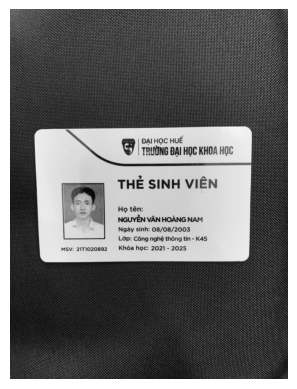

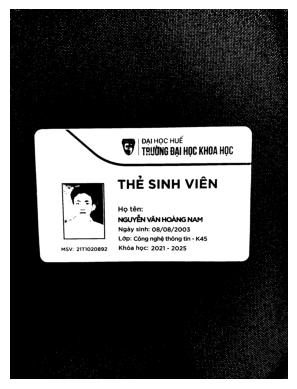

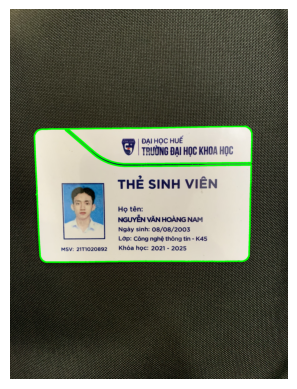

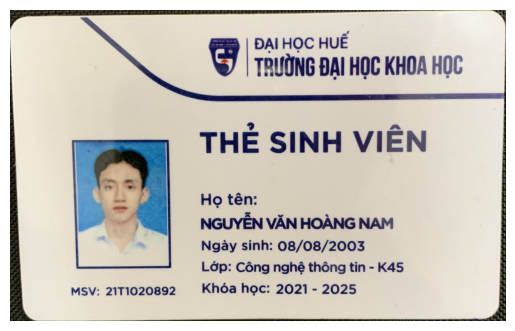

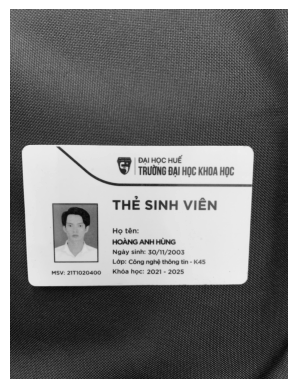

...

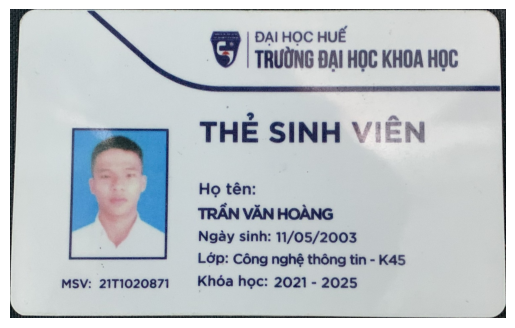

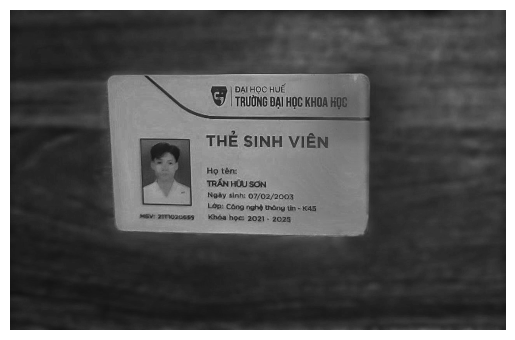

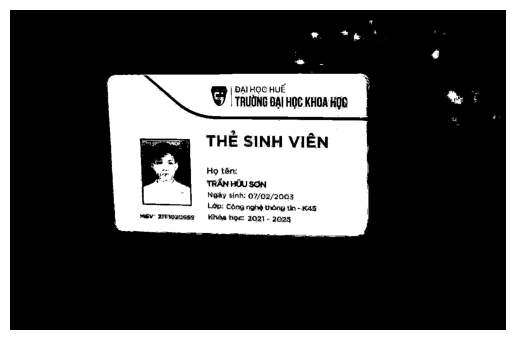

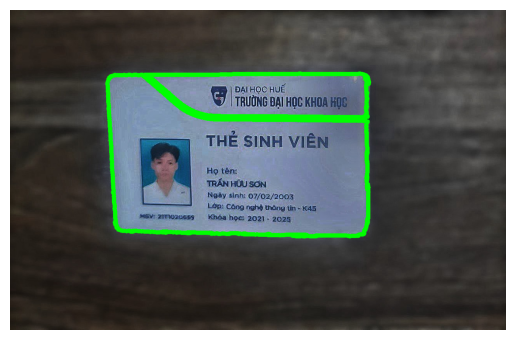

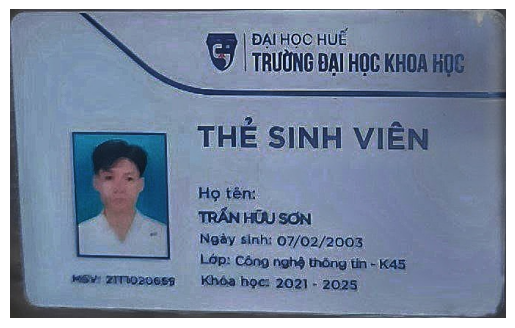

In [ ]:
import cv2
import os
import matplotlib.pyplot as plt

def crop_and_save_images(input_directory, output_directory):
    for filename in os.listdir(input_directory):
        if filename.endswith(".jpg") or filename.endswith(".png") or filename.endswith(".jpeg"): # Chỉ xử lý các tệp có đuôi là .jpg, .jpeg hoặc .png
            input_image_path = os.path.join(input_directory, filename)
            output_image_path = os.path.join(output_directory, filename)
            try:
                # Đọc ảnh
                img = cv2.imread(input_image_path)

                # Chuyển ảnh sang ảnh xám
                gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
                plt.imshow(gray, cmap='gray')
                plt.axis('off')
                plt.show()



                # Chuyển đổi thành ảnh nhị phân bằng phương pháp Thresholding
                _, binary_img = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY | cv2.THRESH_OTSU)
                plt.imshow(binary_img, cmap='gray')
                plt.axis('off')
                plt.show()

                # Tìm các contours trong ảnh
                contours, _ = cv2.findContours(binary_img, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

                # Chọn contour lớn nhất
                largest_contour = max(contours, key=cv2.contourArea)

                # Vẽ contour lớn nhất lên ảnh gốc
                contour_img = img.copy()
                cv2.drawContours(contour_img, [largest_contour], -1, (0, 255, 0), 10) # Vẽ đường viền màu xanh lá (0, 255, 0)

                # Hiển thị ảnh với đường viền lớn nhất
                rgb_contour_img = cv2.cvtColor(contour_img, cv2.COLOR_BGR2RGB)
                plt.imshow(rgb_contour_img)
                plt.axis('off')
                plt.show()

                # Xác định bounding box
                x, y, w, h = cv2.boundingRect(largest_contour)

                # Cắt ảnh theo bounding box
                cropped_img = img[y:y+h, x:x+w]
                rgb_img = cv2.cvtColor(cropped_img, cv2.COLOR_BGR2RGB)

                # Hiển thị ảnh đã cắt
                plt.imshow(rgb_img)
                plt.axis('off')
                plt.show()

                # Lưu ảnh đã cắt vào thư mục đích
                cv2.imwrite(output_image_path, cropped_img)
            except Exception as e:
                print(f"Error processing {input_image_path}: {e}")

# Đường dẫn đến thư mục chứa ảnh gốc
input_directory_path = "/content/drive/MyDrive/Data-do_an_cuoi_ky/test_data"

# Đường dẫn đến thư mục chứa ảnh đã được cắt
output_directory_path = "/content/drive/MyDrive/Data-do_an_cuoi_ky/test_data_cuted&resize"

# Gọi hàm để cắt ảnh và lưu vào thư mục đích
crop_and_save_images(input_directory_path, output_directory_path)

#Resize ảnh thẻ sinh viên

In [ ]:
import cv2
import os

def resize_images_in_directory(input_directory, output_directory, target_width, target_height):
    for filename in os.listdir(input_directory):
        if filename.endswith(".jpg") or filename.endswith(".png")or filename.endswith(".jpeg"): # Chỉ xử lý các tệp có đuôi là .jpg hoặc .png
            input_image_path = os.path.join(input_directory, filename)
            output_image_path = os.path.join(output_directory, filename)
            try:
                img = cv2.imread(input_image_path)
                resized_img = cv2.resize(img, (target_width, target_height))
                print(resized_img.shape)
                cv2.imwrite(output_image_path, resized_img) # Lưu ảnh đã resize vào thư mục đích
            except Exception as e:
                print(f"Error processing {input_image_path}: {e}")

# Đường dẫn đến thư mục chứa ảnh gốc
input_directory_path = "/content/drive/MyDrive/Data-do_an_cuoi_ky/test_data_cuted&resize"

# Đường dẫn đến thư mục chứa ảnh đã resize
output_directory_path = "/content/drive/MyDrive/Data-do_an_cuoi_ky/test_data_cuted&resize"

# Kích thước mới cho ảnh (1500x1100 pixel)
target_width = 1500
target_height = 1100

# Gọi hàm để resize ảnh và lưu vào thư mục đích
resize_images_in_directory(input_directory_path, output_directory_path, target_width, target_height)


(1100, 1500, 3)
(1100, 1500, 3)
(1100, 1500, 3)
(1100, 1500, 3)
(1100, 1500, 3)
(1100, 1500, 3)
(1100, 1500, 3)
(1100, 1500, 3)
(1100, 1500, 3)
(1100, 1500, 3)


#Đọc thông tin nhãn ở tập train & Tính tọa độ 4 góc của mỗi đối tượng

In [ ]:
import xml.etree.ElementTree as ET

# Load file
tree = ET.parse('/content/drive/MyDrive/Data-do_an_cuoi_ky/training_data_segmentation/annotations.xml')
root = tree.getroot()

# Initialize dictionary to store total coordinates for each label
total_coordinates = {}

# Initialize dictionary to store total number of boxes for each label
total_boxes = {}

# Initialize variables to store maximum box for 'hoten' label
max_hoten_box = None
max_hoten_area = -float('inf')

# Iterate through each image
for image in root.findall('image'):
    # Iterate through each box in the image
    for box in image.findall('box'):
        label = box.get('label')
        xtl = float(box.get('xtl'))
        ytl = float(box.get('ytl'))
        xbr = float(box.get('xbr'))
        ybr = float(box.get('ybr'))

        # Initialize total coordinates and total number of boxes for each label if not already present
        if label not in total_coordinates:
            total_coordinates[label] = {
                'top_left_x': 0,
                'top_left_y': 0,
                'top_right_x': 0,
                'top_right_y': 0,
                'bottom_left_x': 0,
                'bottom_left_y': 0,
                'bottom_right_x': 0,
                'bottom_right_y': 0,
            }
            total_boxes[label] = 0

        # Accumulate coordinates for each box
        total_coordinates[label]['top_left_x'] += xtl
        total_coordinates[label]['top_left_y'] += ytl
        total_coordinates[label]['top_right_x'] += xbr
        total_coordinates[label]['top_right_y'] += ytl
        total_coordinates[label]['bottom_left_x'] += xtl
        total_coordinates[label]['bottom_left_y'] += ybr
        total_coordinates[label]['bottom_right_x'] += xbr
        total_coordinates[label]['bottom_right_y'] += ybr
        total_boxes[label] += 1

        # Update maximum box for 'hoten' label
        if label == 'hoten':
            area = (xbr - xtl) * (ybr - ytl)
            if area > max_hoten_area:
                max_hoten_area = area
                max_hoten_box = (xtl, ytl, xbr, ybr)

# Calculate average coordinates for each label
average_coordinates = {}
for label, coords in total_coordinates.items():
    avg_top_left_x = coords['top_left_x'] / total_boxes[label]
    avg_top_left_y = coords['top_left_y'] / total_boxes[label]
    avg_top_right_x = coords['top_right_x'] / total_boxes[label]
    avg_top_right_y = coords['top_right_y'] / total_boxes[label]
    avg_bottom_left_x = coords['bottom_left_x'] / total_boxes[label]
    avg_bottom_left_y = coords['bottom_left_y'] / total_boxes[label]
    avg_bottom_right_x = coords['bottom_right_x'] / total_boxes[label]
    avg_bottom_right_y = coords['bottom_right_y'] / total_boxes[label]

    average_coordinates[label] = {
        'top_left': (avg_top_left_x, avg_top_left_y),
        'top_right': (avg_top_right_x, avg_top_right_y),
        'bottom_left': (avg_bottom_left_x, avg_bottom_left_y),
        'bottom_right': (avg_bottom_right_x, avg_bottom_right_y)
    }

# Print average coordinates for each label
for label, coords in average_coordinates.items():
    if label != 'hoten':
        print(f"Average Coordinates for '{label}':")
        print("Top Left (xtl, ytl):", coords['top_left'])
        print("Top Right (xtr, ytr):", coords['top_right'])
        print("Bottom Left (xbl, ybl):", coords['bottom_left'])
        print("Bottom Right (xbr, ybr):", coords['bottom_right'])

# Print maximum box for 'hoten' label
print("Maximum Box for 'hoten' label:")
print("Top Left (xtl, ytl):", max_hoten_box[:2])
print("Top Right (xtr, ytr):", max_hoten_box[2], max_hoten_box[1])
print("Bottom Left (xbl, ybl):", max_hoten_box[0], max_hoten_box[3])
print("Bottom Right (xbr, ybr):", max_hoten_box[2:])


Average Coordinates for 'lop':
Top Left (xtl, ytl): (561.8979999999999, 855.0944999999999)
Top Right (xtr, ytr): (1207.3857500000001, 855.0944999999999)
Bottom Left (xbl, ybl): (561.8979999999999, 922.6684999999998)
Bottom Right (xbr, ybr): (1207.3857500000001, 922.6684999999998)
Average Coordinates for 'nienkhoa':
Top Left (xtl, ytl): (561.7955, 937.8652500000002)
Top Right (xtr, ytr): (1066.9892499999999, 937.8652500000002)
Bottom Left (xbl, ybl): (561.7955, 1001.3982499999998)
Bottom Right (xbr, ybr): (1066.9892499999999, 1001.3982499999998)
Average Coordinates for 'anhthe':
Top Left (xtl, ytl): (174.64275000000004, 419.5722499999999)
Top Right (xtr, ytr): (489.65250000000003, 419.5722499999999)
Bottom Left (xbl, ybl): (174.64275000000004, 899.0204999999996)
Bottom Right (xbr, ybr): (489.65250000000003, 899.0204999999996)
Average Coordinates for 'ngaysinh':
Top Left (xtl, ytl): (563.1184999999998, 775.776)
Top Right (xtr, ytr): (1083.3740000000003, 775.776)
Bottom Left (xbl, ybl): (

In [ ]:
def get_all_coordinates(average_coordinates, max_hoten_box):
    all_coordinates = []

    # Add coordinates for each label except 'hoten'
    for label, coords in average_coordinates.items():
        if label != 'hoten':
            all_coordinates.append({
                'label': label,
                'top_left': coords['top_left'],
                'top_right': coords['top_right'],
                'bottom_left': coords['bottom_left'],
                'bottom_right': coords['bottom_right']
            })

    # Add coordinates for 'hoten' label
    all_coordinates.append({
        'label': 'hoten',
        'top_left': (max_hoten_box[0], max_hoten_box[1]),
        'top_right': (max_hoten_box[2], max_hoten_box[1]),
        'bottom_left': (max_hoten_box[0], max_hoten_box[3]),
        'bottom_right': (max_hoten_box[2], max_hoten_box[3])
    })

    return all_coordinates

# Example usage:
all_coordinates = get_all_coordinates(average_coordinates, max_hoten_box)
print(all_coordinates)


[{'label': 'lop', 'top_left': (561.8979999999999, 855.0944999999999), 'top_right': (1207.3857500000001, 855.0944999999999), 'bottom_left': (561.8979999999999, 922.6684999999998), 'bottom_right': (1207.3857500000001, 922.6684999999998)}, {'label': 'nienkhoa', 'top_left': (561.7955, 937.8652500000002), 'top_right': (1066.9892499999999, 937.8652500000002), 'bottom_left': (561.7955, 1001.3982499999998), 'bottom_right': (1066.9892499999999, 1001.3982499999998)}, {'label': 'anhthe', 'top_left': (174.64275000000004, 419.5722499999999), 'top_right': (489.65250000000003, 419.5722499999999), 'bottom_left': (174.64275000000004, 899.0204999999996), 'bottom_right': (489.65250000000003, 899.0204999999996)}, {'label': 'ngaysinh', 'top_left': (563.1184999999998, 775.776), 'top_right': (1083.3740000000003, 775.776), 'bottom_left': (563.1184999999998, 841.5652499999999), 'bottom_right': (1083.3740000000003, 841.5652499999999)}, {'label': 'msv', 'top_left': (150.86325, 947.2790000000001), 'top_right': (5

#Áp dụng template lên ảnh & Trích xuất các vùng thông tin

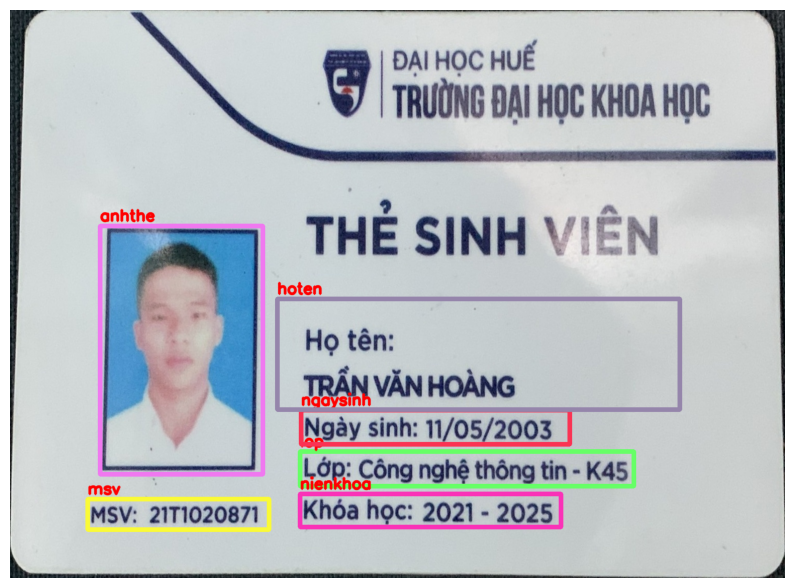

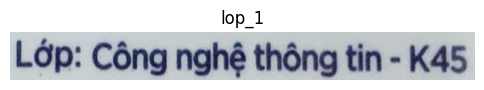

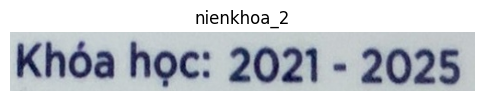

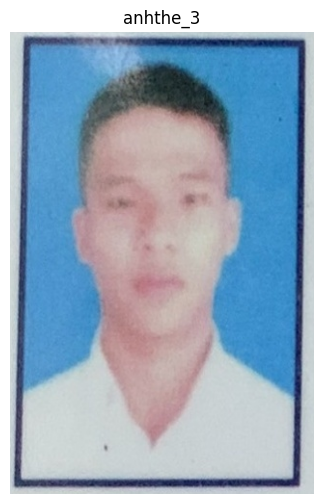

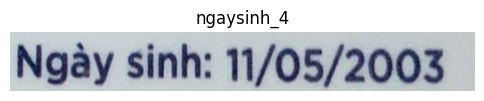

...

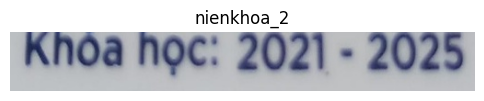

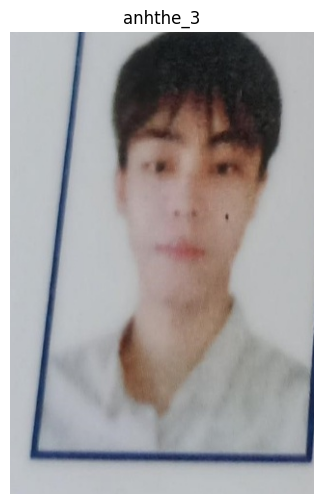

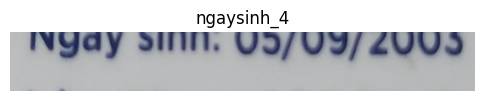

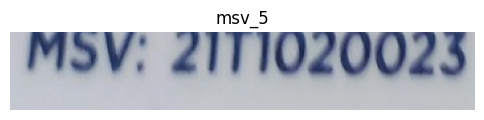

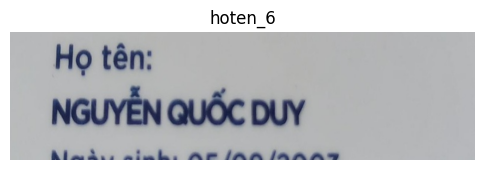

In [ ]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
import os

# Hàm để đọc file labelmap và lưu trữ màu sắc tương ứng với từng nhãn vào từ điển
def load_label_colors(labelmap_path):
    label_colors = {}
    with open(labelmap_path, 'r') as file:
        for line in file:
            if line.strip() and not line.startswith('#'):
                parts = line.strip().split(':')
                label = parts[0]
                color_str = parts[1]
                if color_str:
                    color_rgb = tuple(map(int, color_str.split(',')))
                    label_colors[label] = color_rgb
    return label_colors

# Hàm để vẽ các bounding box trên ảnh
def draw_bounding_boxes(image_path, result, label_colors):
    # Đọc ảnh
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Chuyển ảnh sang RGB cho matplotlib

    # Vẽ các bounding box
    for box in result:
        label = box['label']
        top_left = tuple(map(int, box['top_left']))
        top_right = tuple(map(int, box['top_right']))
        bottom_left = tuple(map(int, box['bottom_left']))
        bottom_right = tuple(map(int, box['bottom_right']))

        # Lấy màu cho nhãn từ từ điển
        color = label_colors.get(label, (0, 0, 255))  # Mặc định là màu đỏ nếu không tìm thấy nhãn

        # Vẽ bounding box
        pts = np.array([top_left, top_right, bottom_right, bottom_left], np.int32)
        pts = pts.reshape((-1, 1, 2))
        cv2.polylines(image, [pts], isClosed=True, color=color, thickness=7)

        # Hiển thị nhãn gần bounding box
        font = cv2.FONT_HERSHEY_SIMPLEX
        font_scale = 1.0  # Tăng kích thước font cho chữ to hơn
        font_thickness = 3  # Tăng độ dày để dễ nhìn hơn
        text_color = (255, 0, 0)  # Màu đỏ trong RGB
        text_size, _ = cv2.getTextSize(label, font, font_scale, font_thickness)
        text_w, text_h = text_size

        # Điều chỉnh vị trí của nhãn
        text_bottom_left = (top_left[0], top_left[1] - 10 if top_left[1] - 10 > text_h else top_left[1] + text_h + 10)
        cv2.putText(image, label, text_bottom_left, font, font_scale, text_color, font_thickness, lineType=cv2.LINE_AA)

    # Hiển thị ảnh với các bounding box
    plt.figure(figsize=(10, 8))
    plt.imshow(image)
    plt.axis('off')
    plt.show()

# Hàm để cắt và hiển thị các vùng của bounding box
def crop_and_display_boxes(image_path, result):
    # Đọc ảnh
    image = cv2.imread(image_path)

    # Khởi tạo bộ đếm cho tên ảnh
    img_count = 1

    # Cắt và hiển thị bounding box
    for box in result:
        label = box['label']
        top_left = box['top_left']
        bottom_right = box['bottom_right']

        # Lấy tọa độ
        x1, y1 = int(top_left[0]), int(top_left[1])
        x2, y2 = int(bottom_right[0]), int(bottom_right[1])

        # Cắt ảnh
        cropped_image = image[y1:y2, x1:x2]

        # Hiển thị ảnh đã cắt
        plt.figure(figsize=(6, 6))
        plt.imshow(cv2.cvtColor(cropped_image, cv2.COLOR_BGR2RGB))
        plt.axis('off')
        plt.title(f'{label}_{img_count}')
        plt.show()

        # Tăng bộ đếm ảnh
        img_count += 1

# Sử dụng ví dụ:
input_directory = '/content/drive/MyDrive/Data-do_an_cuoi_ky/test_data_cuted&resize'
labelmap_path = '/content/drive/MyDrive/Data-do_an_cuoi_ky/training_data_segmentation/labelmap.txt'

# Đọc file labelmap và lưu màu sắc cho từng nhãn
label_colors = load_label_colors(labelmap_path)

# Duyệt qua các file ảnh trong thư mục
for filename in os.listdir(input_directory):
    if filename.endswith(".jpg") or filename.endswith(".png") or filename.endswith(".jpeg"):  # Chỉ xử lý các tệp có đuôi là .jpg, .jpeg hoặc .png
        image_path = os.path.join(input_directory, filename)

        # Giả định hàm get_all_coordinates trả về danh sách các bounding box cho ảnh
        result = get_all_coordinates(average_coordinates, max_hoten_box)

        # Vẽ bounding box với màu sắc tương ứng
        draw_bounding_boxes(image_path, result, label_colors)

        # Cắt và hiển thị các vùng bounding box
        crop_and_display_boxes(image_path, result)


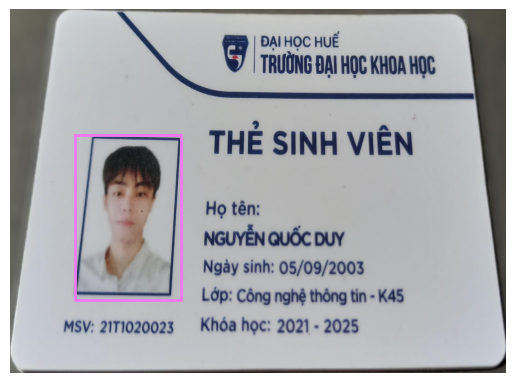

Label: anhthe
Coordinates: (195.15, 380.73) (517.04, 877.54)


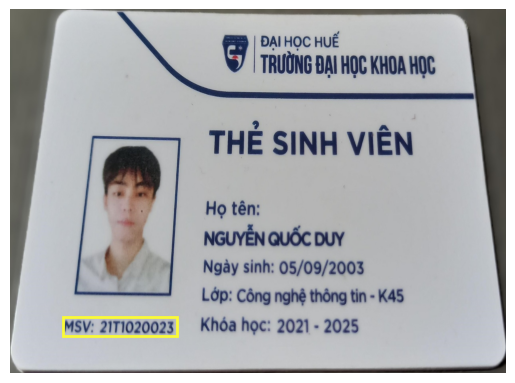

Label: msv
Coordinates: (158.77, 929.33) (505.84, 986.71)


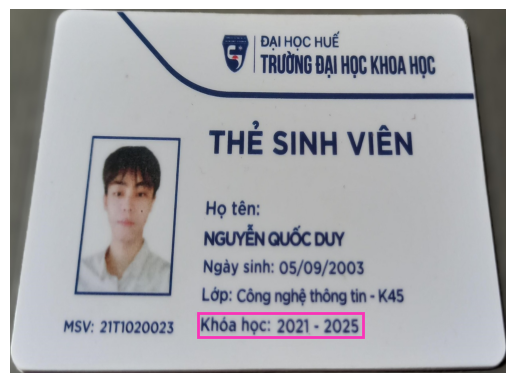

Label: nienkhoa
Coordinates: (567.42, 916.73) (1065.64, 990.9)


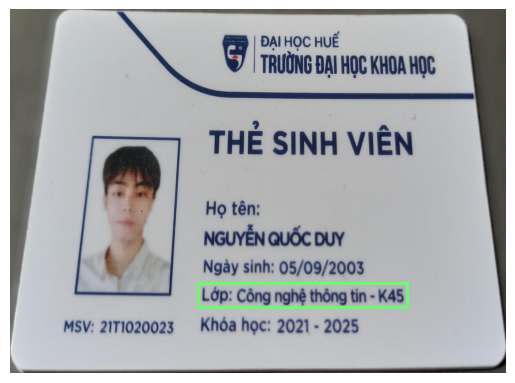

Label: lop
Coordinates: (567.42, 827.16) (1201.39, 899.94)


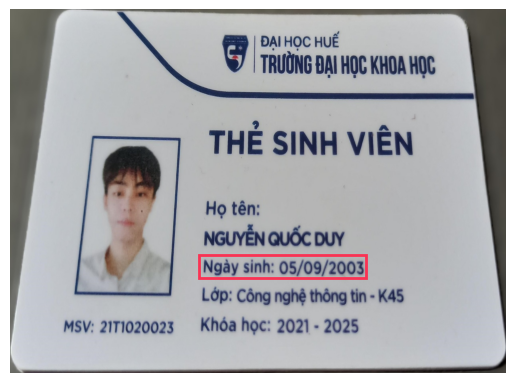

Label: ngaysinh
Coordinates: (570.22, 741.79) (1075.43, 811.77)


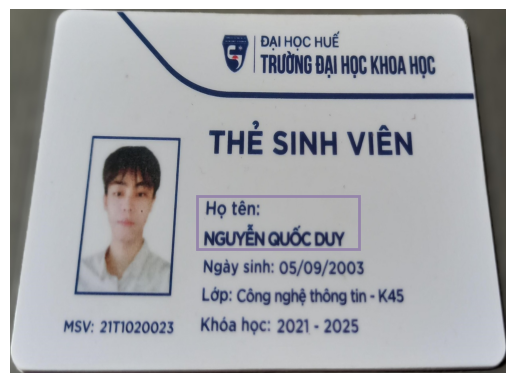

Label: hoten
Coordinates: (566.02, 565.46) (1054.44, 723.6)


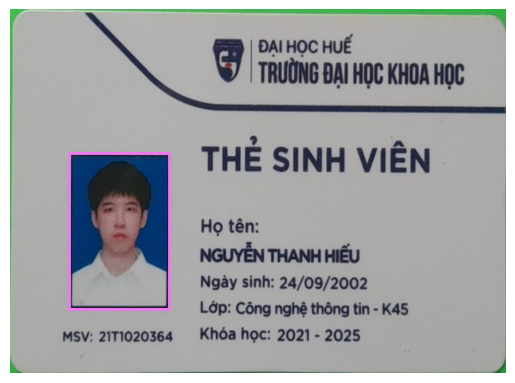

Label: anhthe
Coordinates: (178.36, 433.91) (480.65, 906.93)


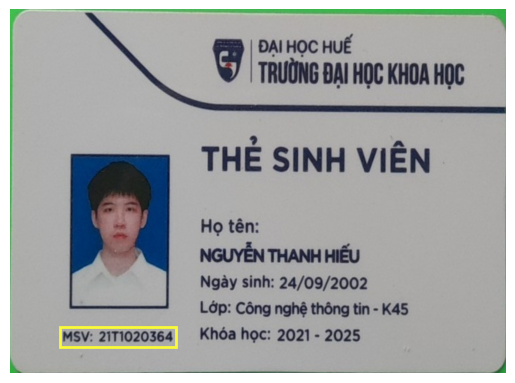

Label: msv
Coordinates: (151.77, 961.51) (500.24, 1021.69)


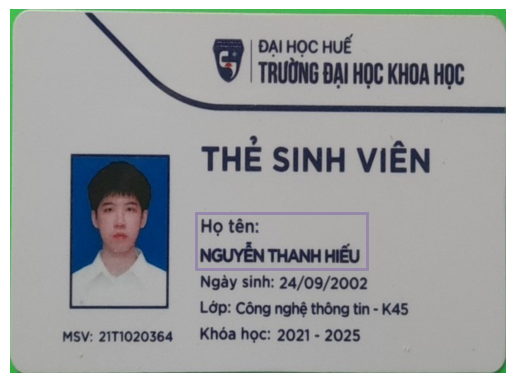

Label: hoten
Coordinates: (561.82, 615.84) (1078.23, 785.18)


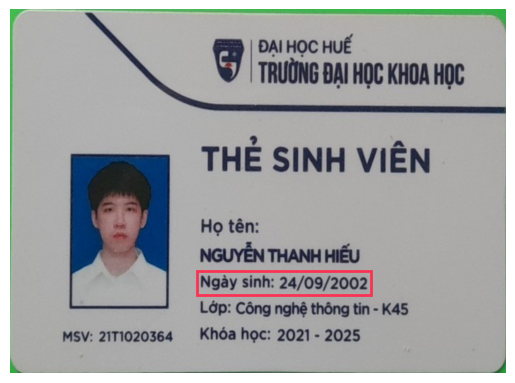

Label: ngaysinh
Coordinates: (566.02, 790.78) (1090.83, 863.55)


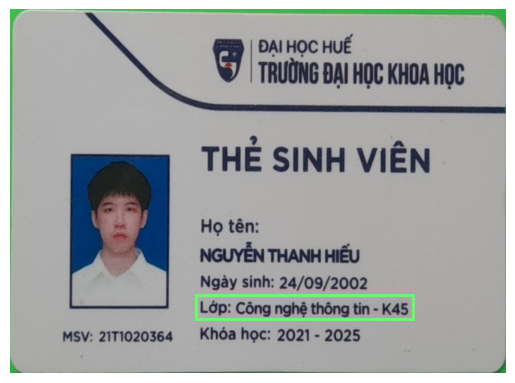

Label: lop
Coordinates: (563.22, 864.95) (1219.58, 936.32)


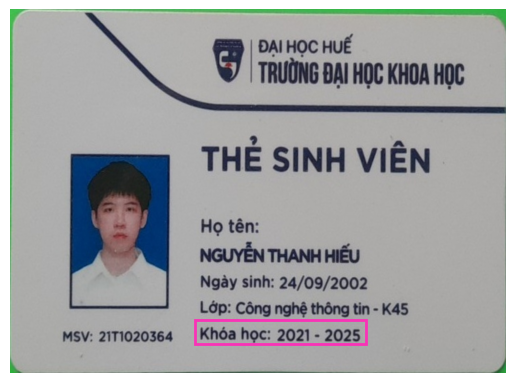

Label: nienkhoa
Coordinates: (560.42, 939.12) (1075.43, 1011.9)


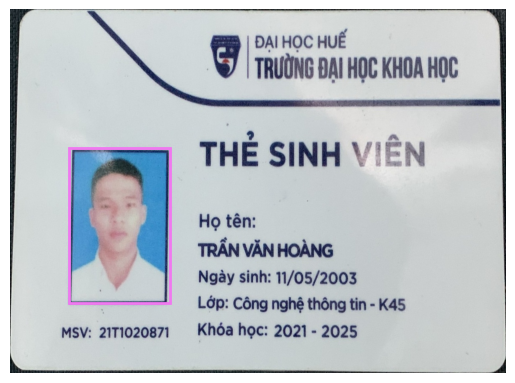

Label: anhthe
Coordinates: (178.36, 419.91) (482.05, 888.74)


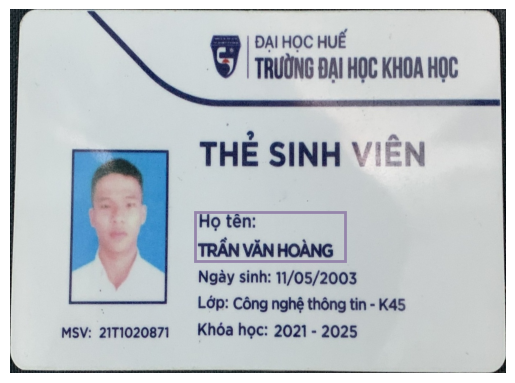

Label: hoten
Coordinates: (560.42, 611.64) (1012.46, 761.39)


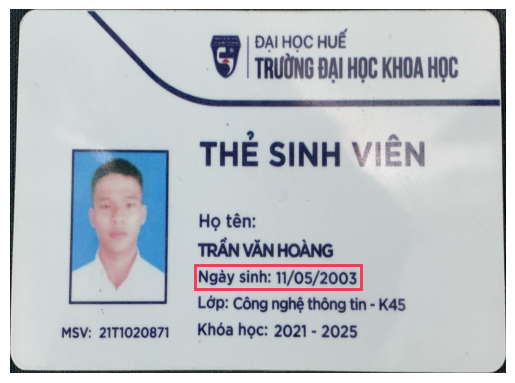

Label: ngaysinh
Coordinates: (559.02, 773.98) (1061.44, 843.96)


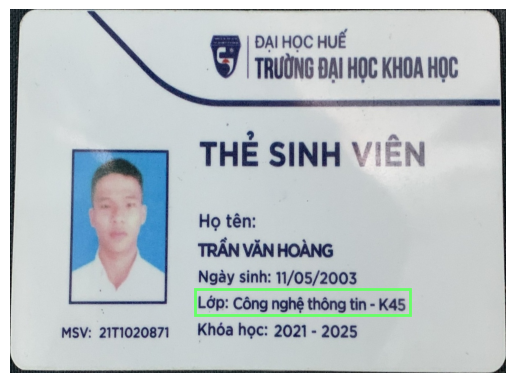

Label: lop
Coordinates: (557.62, 843.96) (1209.78, 925.13)


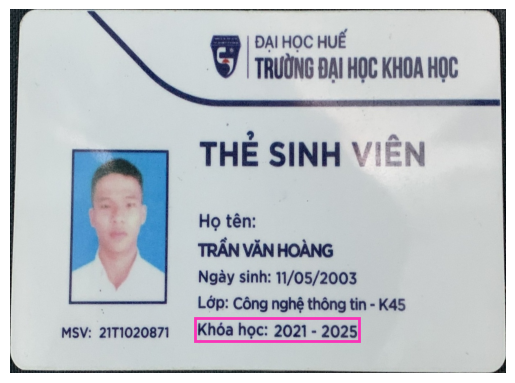

Label: nienkhoa
Coordinates: (560.42, 932.12) (1055.84, 1003.5)


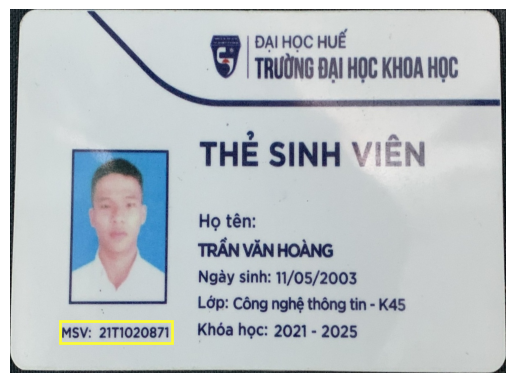

Label: msv
Coordinates: (151.77, 943.32) (490.45, 1007.7)


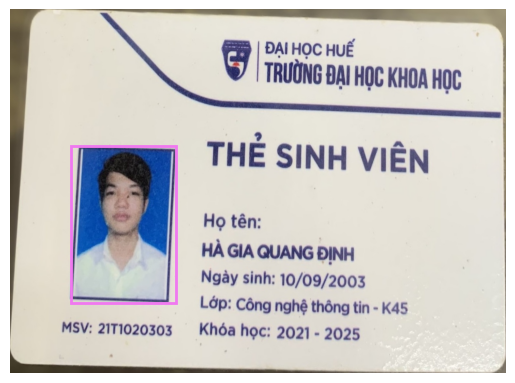

Label: anhthe
Coordinates: (185.36, 414.31) (500.24, 888.74)


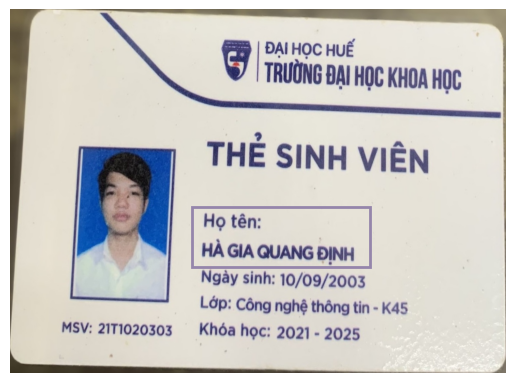

Label: hoten
Coordinates: (549.22, 597.65) (1088.03, 779.58)


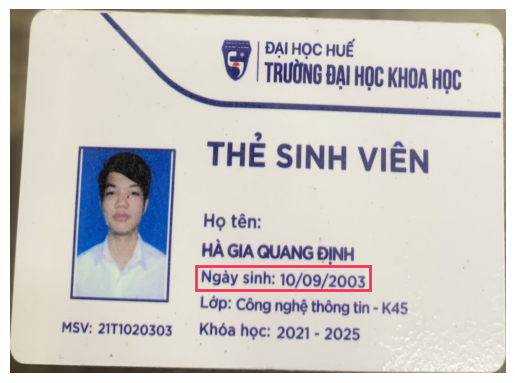

Label: ngaysinh
Coordinates: (563.22, 775.38) (1088.03, 849.6)


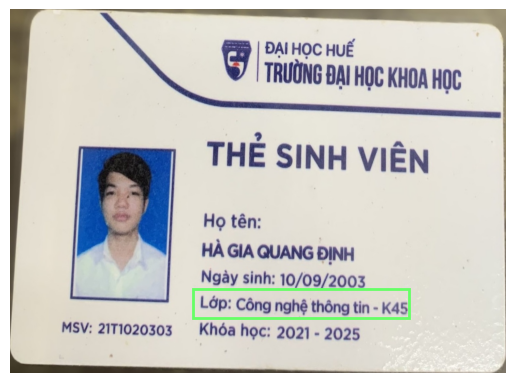

Label: lop
Coordinates: (552.02, 846.76) (1206.98, 933.52)


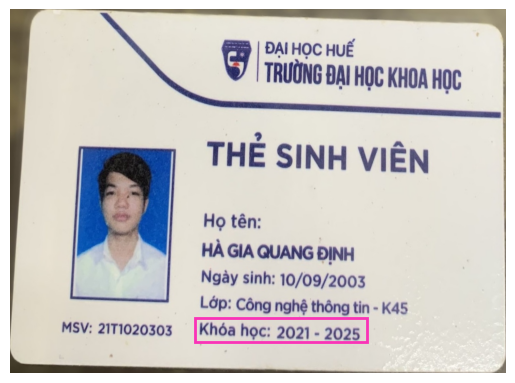

Label: nienkhoa
Coordinates: (559.02, 932.12) (1078.23, 1006.3)


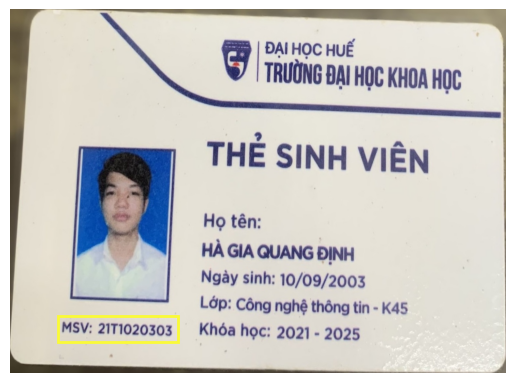

Label: msv
Coordinates: (143.37, 926.53) (507.24, 1006.3)


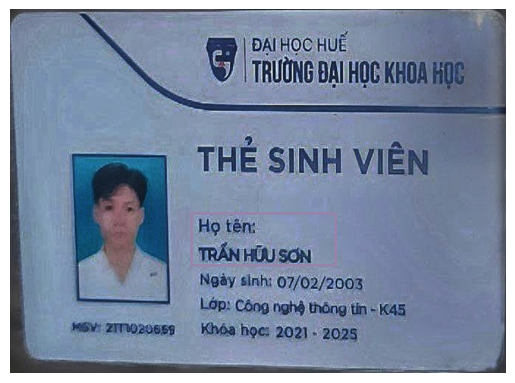

Label: hoten
Coordinates: (546.43, 615.84) (981.67, 772.58)


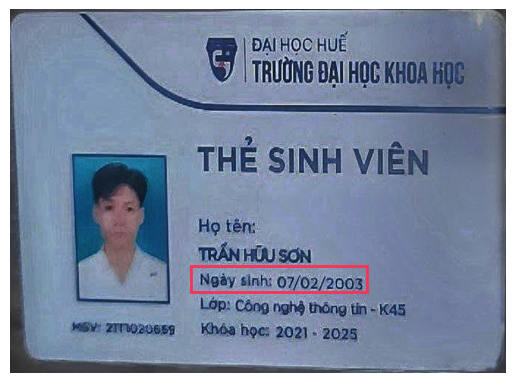

Label: ngaysinh
Coordinates: (546.43, 775.38) (1079.63, 855.15)


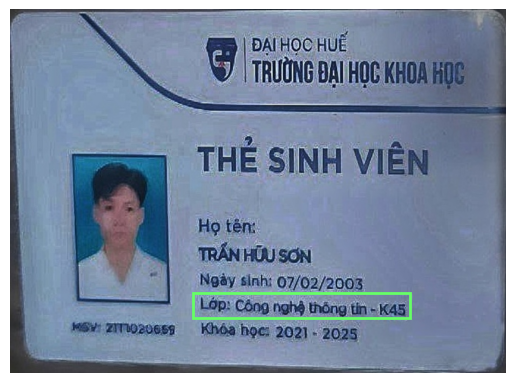

Label: lop
Coordinates: (553.42, 857.95) (1208.38, 933.52)


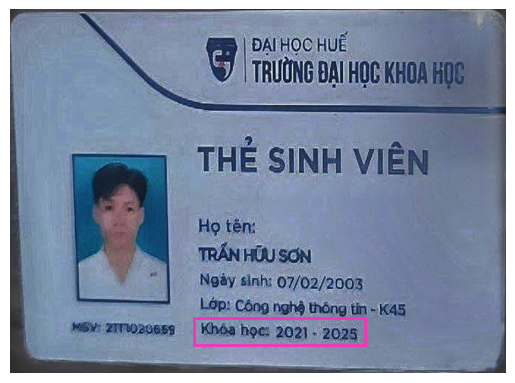

Label: nienkhoa
Coordinates: (554.82, 932.12) (1074.03, 1014.69)


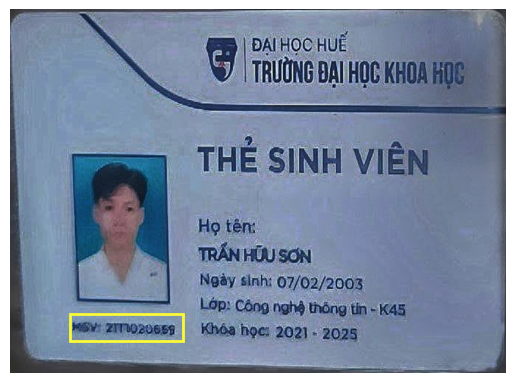

Label: msv
Coordinates: (179.76, 920.93) (521.23, 1003.5)


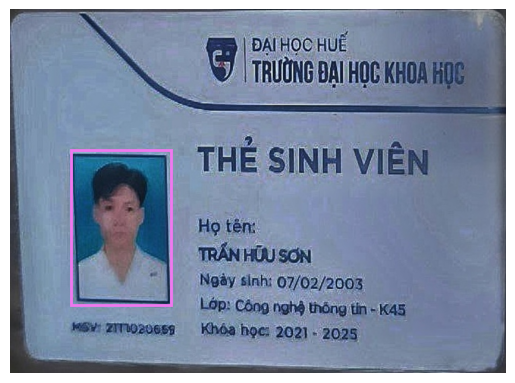

Label: anhthe
Coordinates: (184.0, 424.11) (487.65, 894.34)


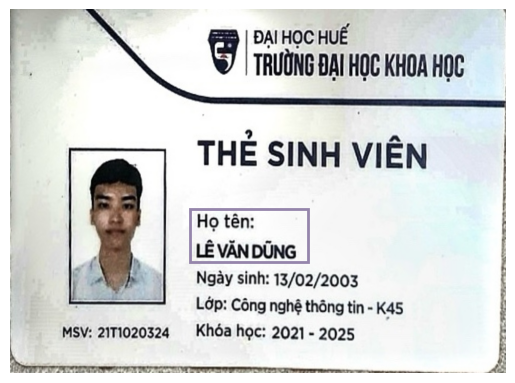

Label: hoten
Coordinates: (543.63, 604.64) (901.9, 762.79)


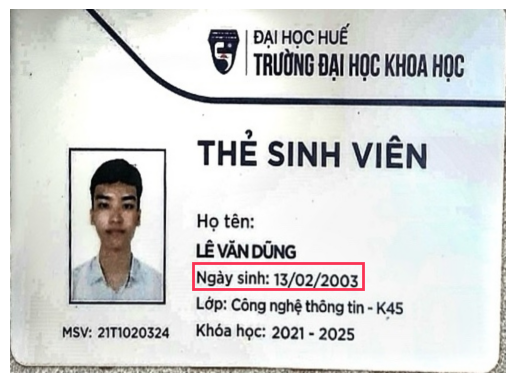

Label: ngaysinh
Coordinates: (552.02, 765.59) (1065.64, 846.76)


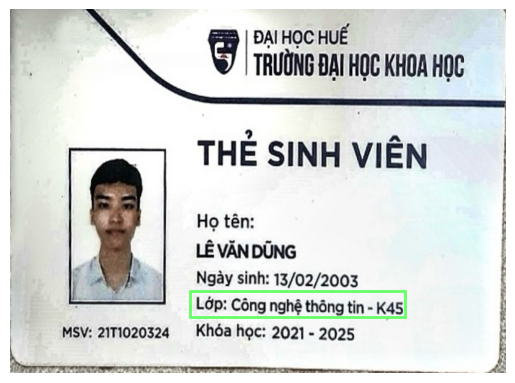

Label: lop
Coordinates: (545.03, 850.95) (1194.39, 929.33)


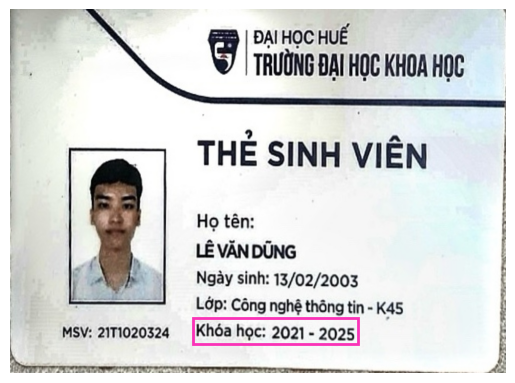

Label: nienkhoa
Coordinates: (552.02, 933.52) (1053.04, 1010.5)


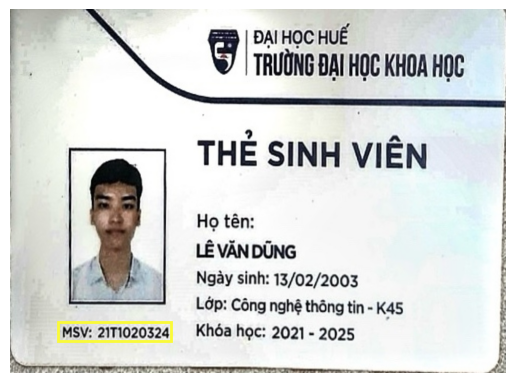

Label: msv
Coordinates: (143.37, 946.12) (487.65, 1002.1)


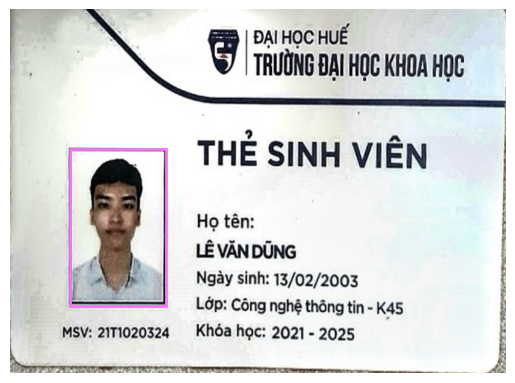

Label: anhthe
Coordinates: (179.8, 421.3) (472.25, 895.74)


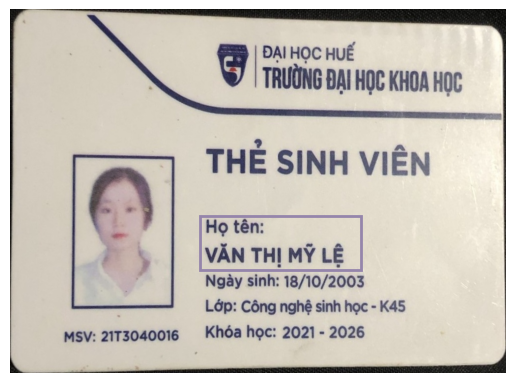

Label: hoten
Coordinates: (574.41, 624.24) (1061.44, 786.58)


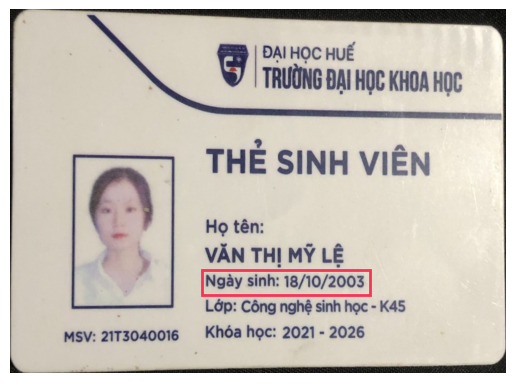

Label: ngaysinh
Coordinates: (580.01, 787.98) (1089.43, 862.15)


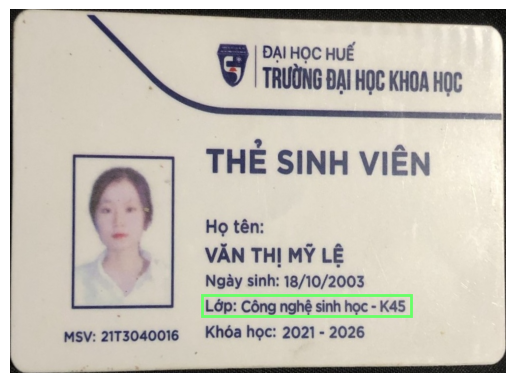

Label: lop
Coordinates: (580.01, 862.15) (1212.58, 926.53)


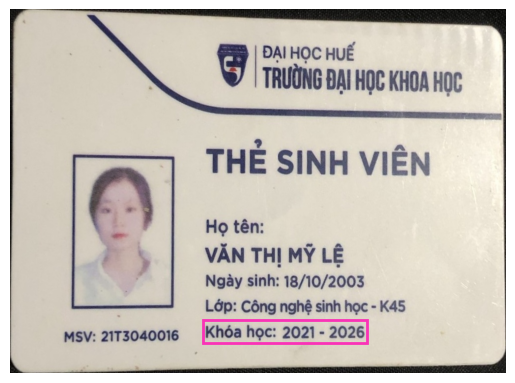

Label: nienkhoa
Coordinates: (584.21, 937.72) (1079.63, 1007.7)


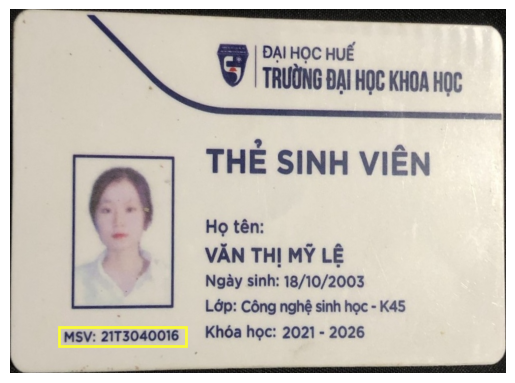

Label: msv
Coordinates: (148.97, 960.11) (531.03, 1017.49)


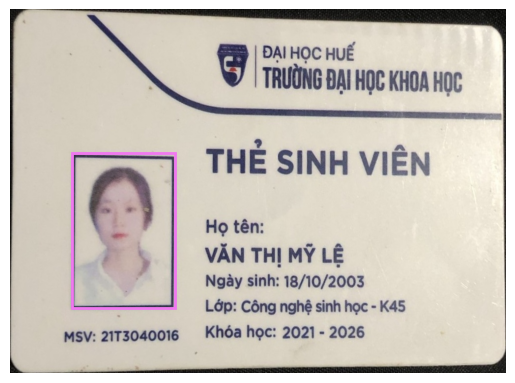

Label: anhthe
Coordinates: (188.16, 435.31) (498.84, 902.74)


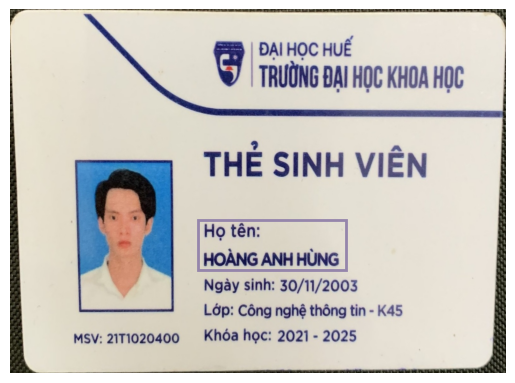

Label: hoten
Coordinates: (568.82, 635.43) (1016.65, 786.58)


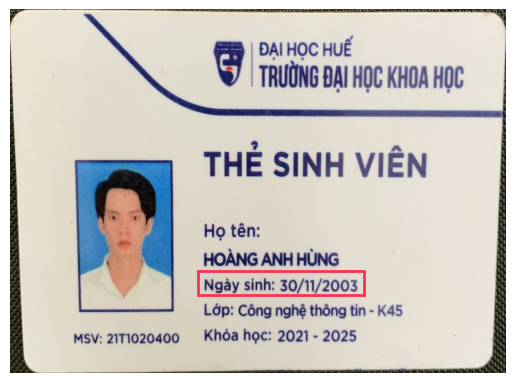

Label: ngaysinh
Coordinates: (568.82, 792.18) (1071.23, 862.15)


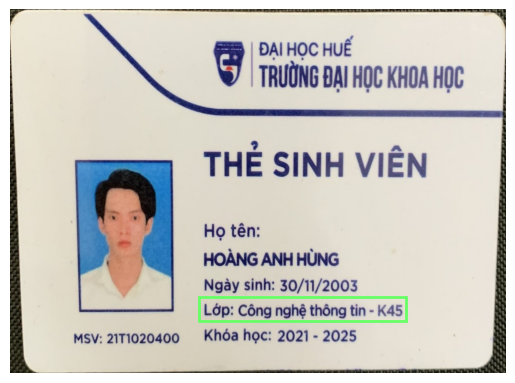

Label: lop
Coordinates: (571.62, 869.15) (1195.79, 943.32)


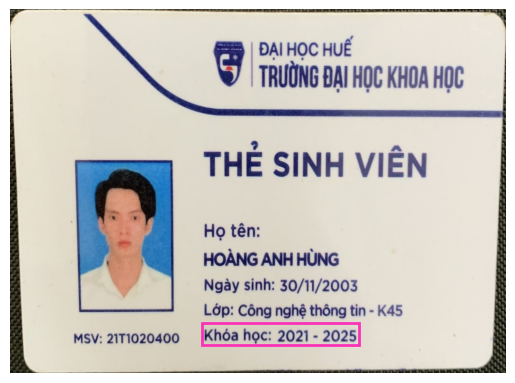

Label: nienkhoa
Coordinates: (581.41, 947.52) (1055.84, 1016.09)


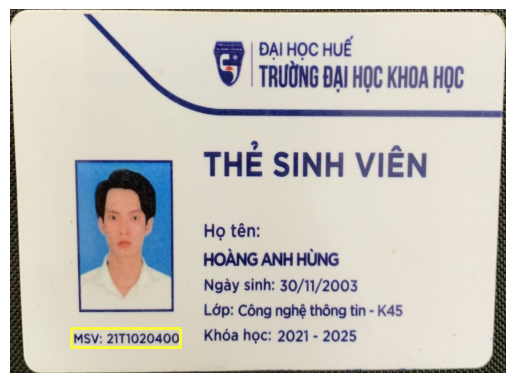

Label: msv
Coordinates: (185.36, 962.91) (514.24, 1020.29)


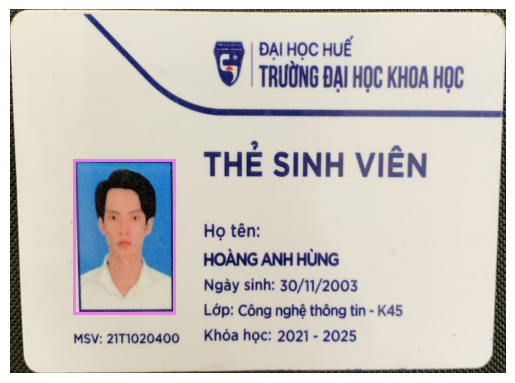

Label: anhthe
Coordinates: (193.75, 456.3) (496.04, 918.1)


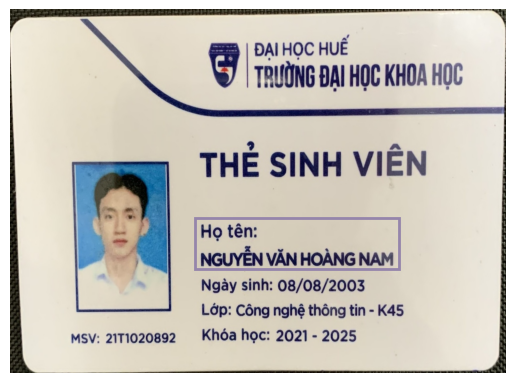

Label: hoten
Coordinates: (560.42, 629.83) (1176.2, 785.18)


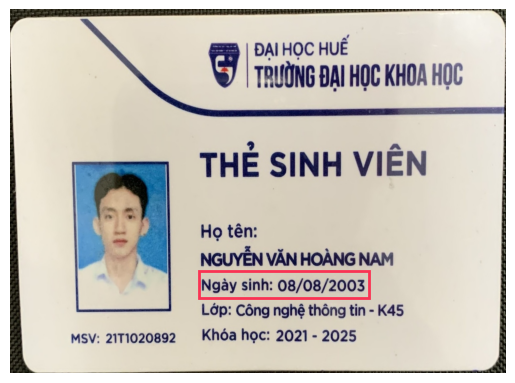

Label: ngaysinh
Coordinates: (571.62, 792.18) (1083.83, 873.35)


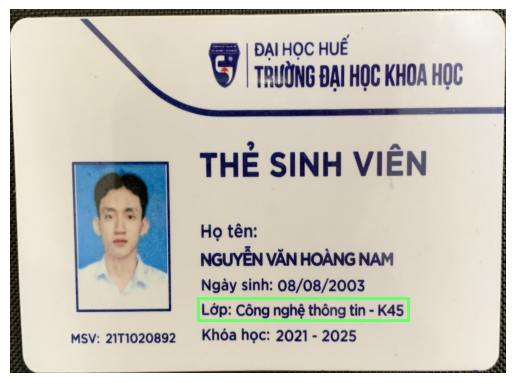

Label: lop
Coordinates: (568.82, 873.35) (1204.19, 939.12)


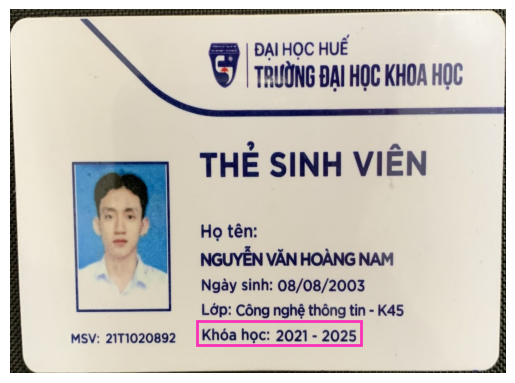

Label: nienkhoa
Coordinates: (566.02, 943.32) (1060.04, 1016.09)


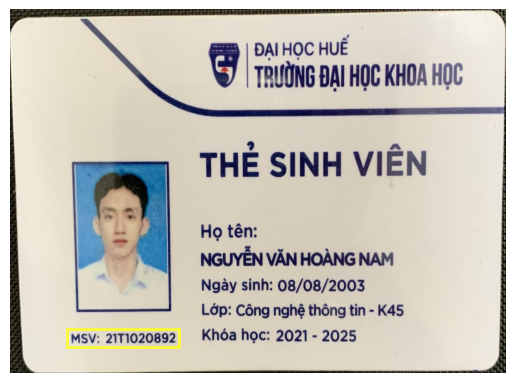

Label: msv
Coordinates: (171.36, 967.11) (510.04, 1021.69)


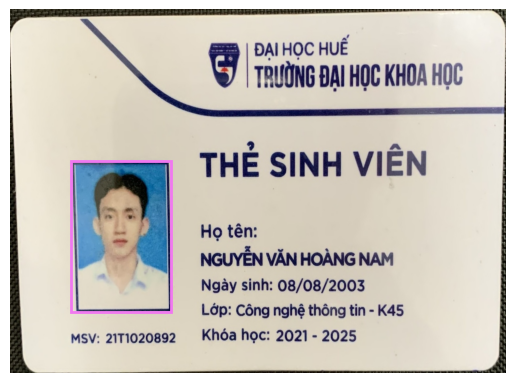

Label: anhthe
Coordinates: (183.96, 459.1) (486.25, 915.33)


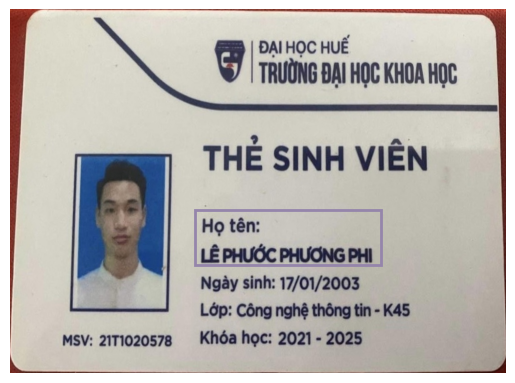

Label: hoten
Coordinates: (560.42, 607.44) (1121.62, 772.58)


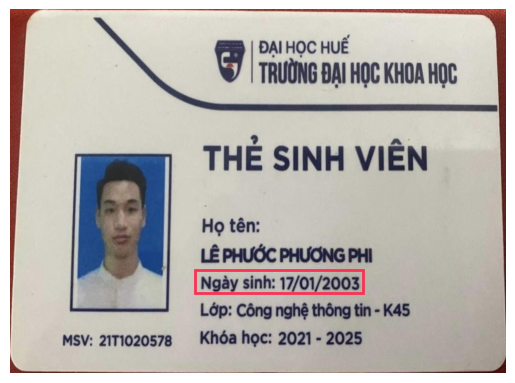

Label: ngaysinh
Coordinates: (557.62, 789.38) (1067.04, 856.55)


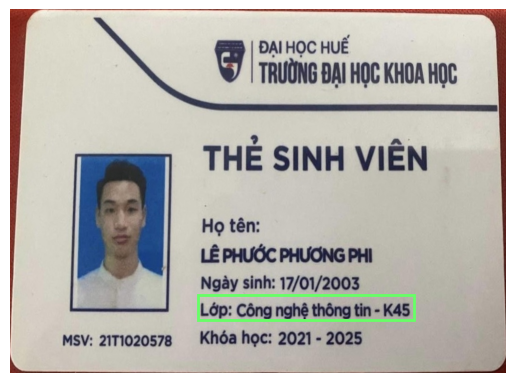

Label: lop
Coordinates: (568.82, 862.15) (1222.38, 940.52)


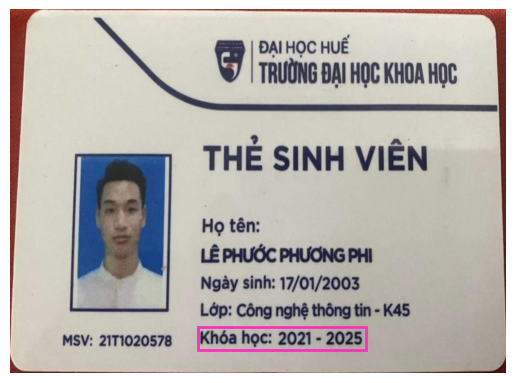

Label: nienkhoa
Coordinates: (567.42, 961.51) (1075.43, 1030.09)


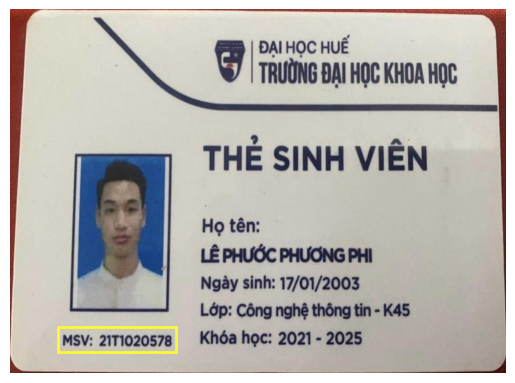

Label: msv
Coordinates: (146.17, 961.51) (501.64, 1035.69)


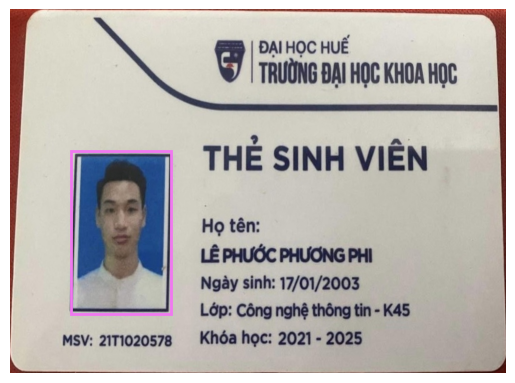

Label: anhthe
Coordinates: (182.56, 428.31) (486.25, 922.33)


In [ ]:
import cv2
import xml.etree.ElementTree as ET
import matplotlib.pyplot as plt

# Đọc thông tin từ file annotation.xml
tree = ET.parse('/content/drive/MyDrive/Data-do_an_cuoi_ky/test_data_Segmentation/annotations.xml')
root = tree.getroot()

# Đọc thông tin từ file labelmap.txt
label_colors = {}
with open('/content/drive/MyDrive/Data-do_an_cuoi_ky/test_data_Segmentation/labelmap.txt', 'r') as file:
    for line in file:
        if line.startswith('#') or line.strip() == '':
            continue
        parts = line.strip().split(':')
        label = parts[0]
        color_rgb = tuple(map(int, parts[1].split(',')))
        label_colors[label] = color_rgb

# Lặp qua từng ảnh và vẽ hộp cho các đối tượng của ảnh đó
for image in root.findall('image'):
    image_name = image.get('name')
    image_path = '/content/drive/MyDrive/Data-do_an_cuoi_ky/test_data_cuted&resize' + image_name
    img = cv2.imread(image_path)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    for box in image.findall('box'):
        label = box.get('label')
        color = label_colors.get(label, (255, 255, 255))  # Nếu không tìm thấy màu, mặc định là trắng
        xtl, ytl, xbr, ybr = map(float, (box.get('xtl'), box.get('ytl'), box.get('xbr'), box.get('ybr')))

        # Tạo hình ảnh mới và vẽ hộp cho đối tượng đó
        object_img = img_rgb.copy()
        plt.imshow(object_img)
        plt.axis('off')
        plt.gca().add_patch(plt.Rectangle((xtl, ytl), xbr - xtl, ybr - ytl, linewidth=2, edgecolor=[x / 255 for x in color], facecolor='none'))
        plt.show()

        print("Label:", label)
        print("Coordinates:", (xtl, ytl), (xbr, ybr))


#Đánh giá bằng độ đo IoU

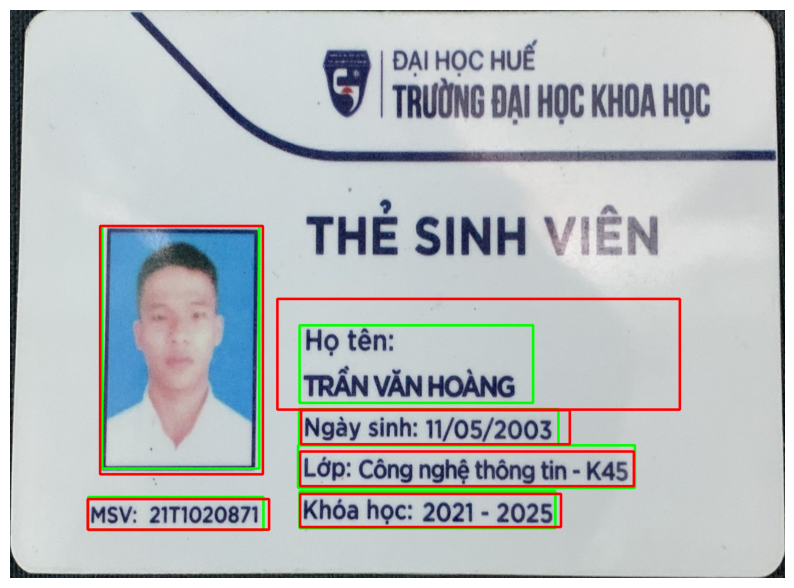

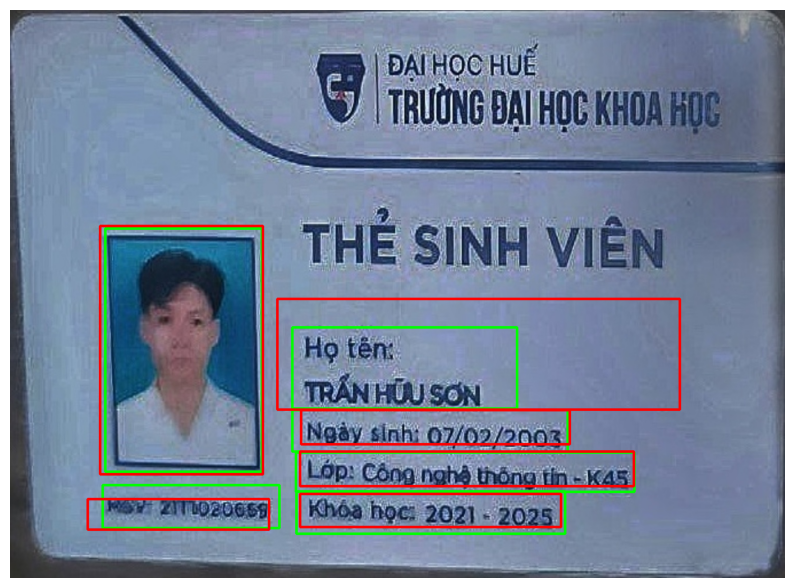

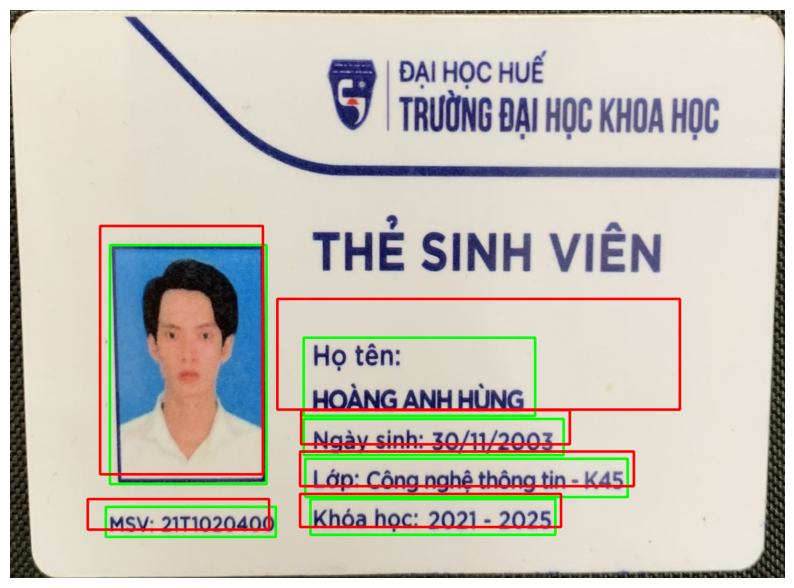

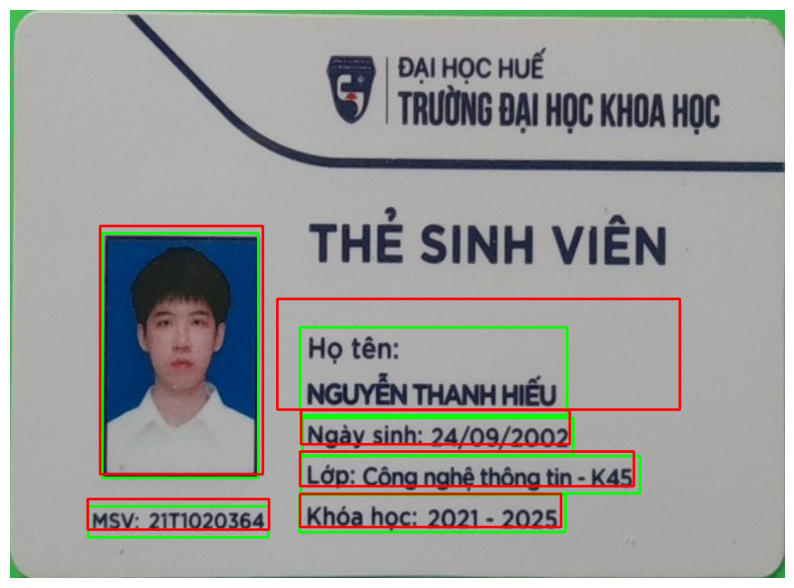

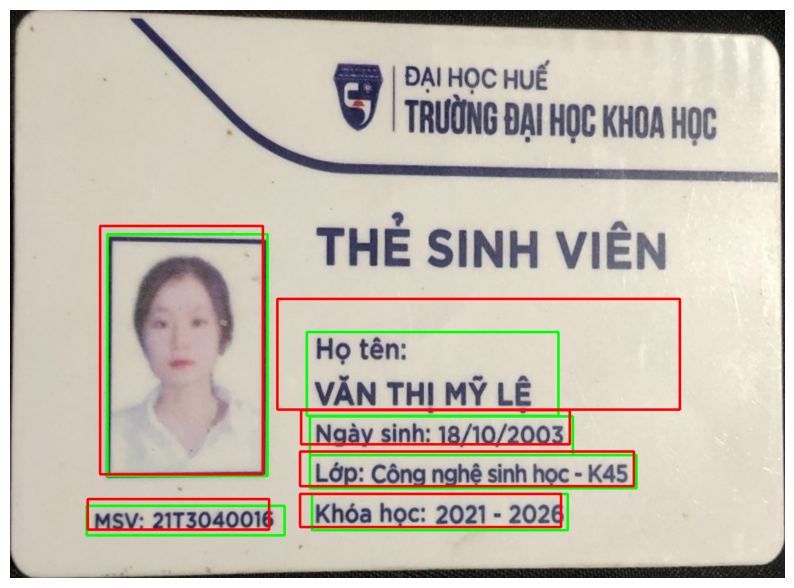

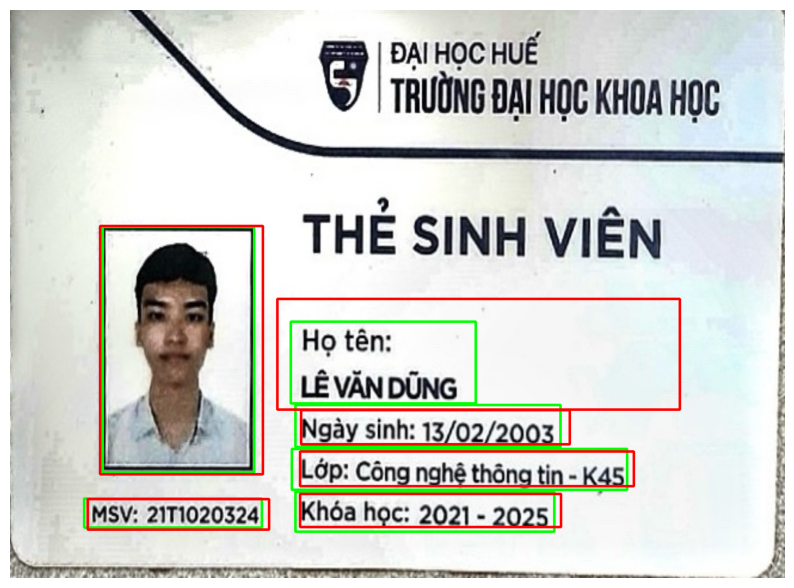

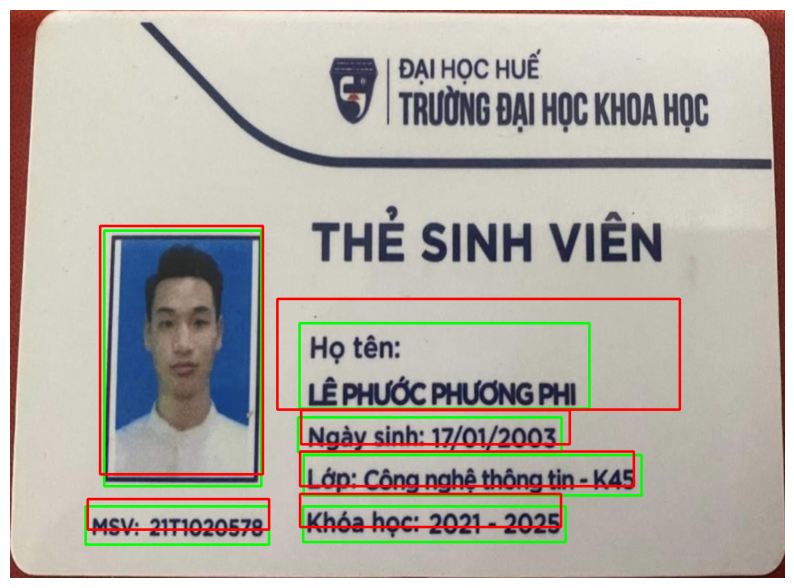

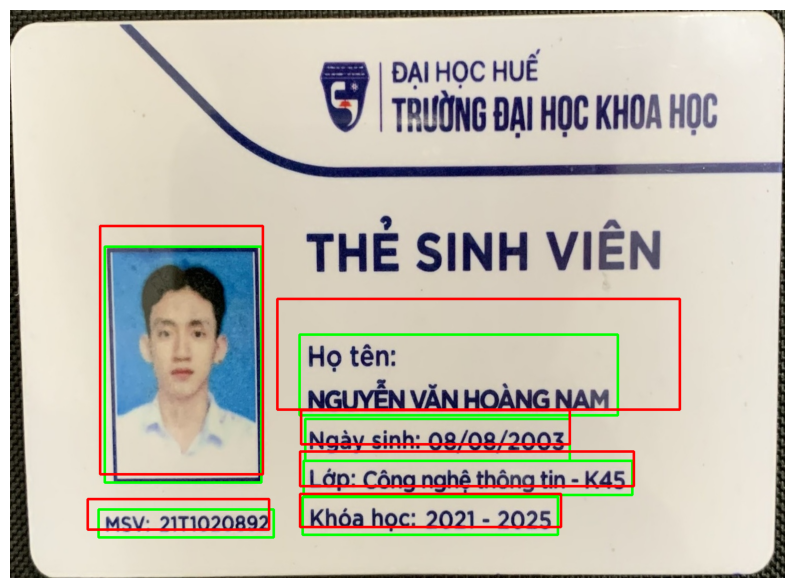

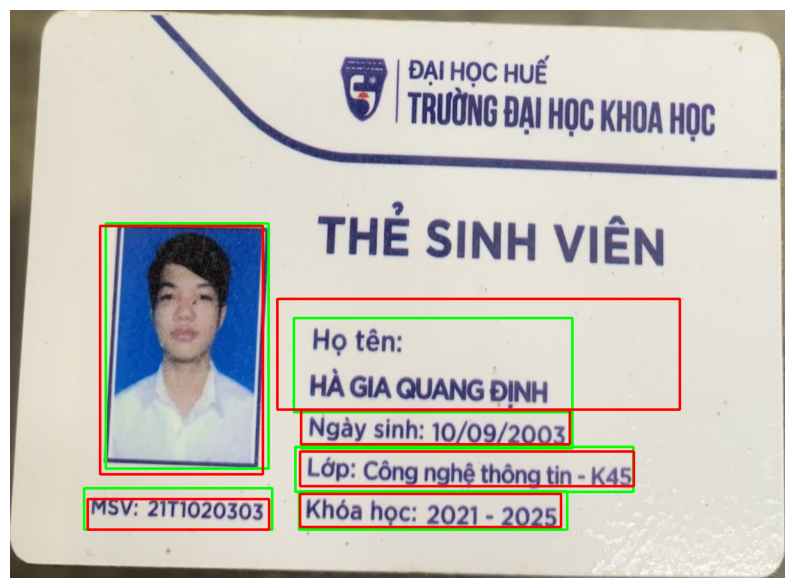

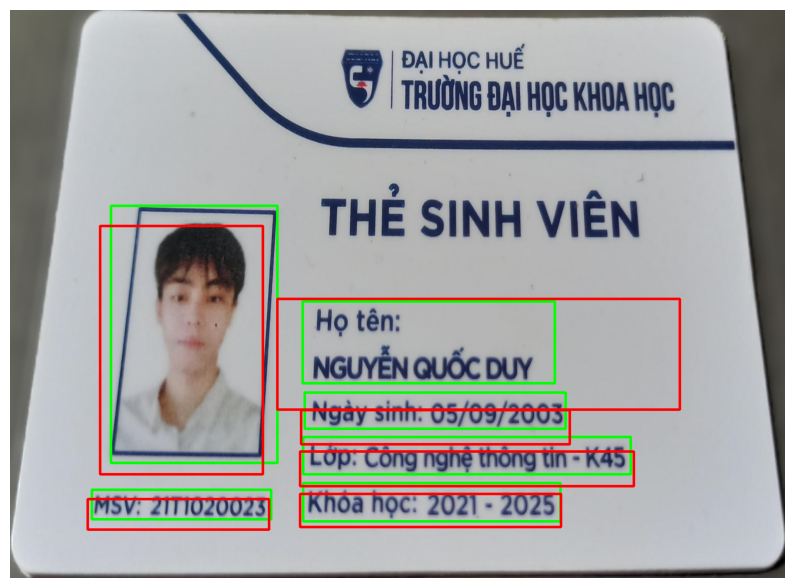

In [ ]:
import cv2
import xml.etree.ElementTree as ET
import matplotlib.pyplot as plt
import numpy as np
import os

# Hàm để đọc file labelmap và lưu trữ màu sắc tương ứng với từng nhãn vào từ điển
def load_label_colors(labelmap_path):
    label_colors = {}
    with open(labelmap_path, 'r') as file:
        for line in file:
            if line.strip() and not line.startswith('#'):
                parts = line.strip().split(':')
                label = parts[0]
                color_str = parts[1]
                if color_str:
                    color_rgb = tuple(map(int, color_str.split(',')))
                    label_colors[label] = color_rgb
    return label_colors

# Hàm để vẽ các bounding box trên ảnh
def draw_bounding_boxes(image_path, ground_truth, predictions, label_colors):
    # Đọc ảnh
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Chuyển ảnh sang RGB cho matplotlib

    # Vẽ bounding box cho ground truth màu xanh
    for box in ground_truth:
        label = box['label']
        top_left = tuple(map(int, box['top_left']))
        bottom_right = tuple(map(int, box['bottom_right']))
        cv2.rectangle(image, top_left, bottom_right, (0, 255, 0), 3)  # Màu xanh cho ground truth

    # Vẽ bounding box cho dự đoán màu đỏ
    for box in predictions:
        label = box['label']
        top_left = tuple(map(int, box['top_left']))
        bottom_right = tuple(map(int, box['bottom_right']))
        cv2.rectangle(image, top_left, bottom_right, (255, 0, 0), 3)  # Màu đỏ cho dự đoán

    # Hiển thị ảnh với các bounding box
    plt.figure(figsize=(10, 8))
    plt.imshow(image)
    plt.axis('off')
    plt.show()

# Đọc các nhãn từ labelmap
def load_labels(labelmap_path):
    labels = []
    with open(labelmap_path, 'r') as file:
        for line in file:
            if line.strip() and not line.startswith('#'):
                parts = line.strip().split(':')
                label = parts[0]
                labels.append(label)
    return labels

def get_ground_truth_and_predictions(image_name):
    ground_truth = []
    predictions = []

    # Đọc thông tin từ file annotation.xml
    tree = ET.parse('/content/drive/MyDrive/Data-do_an_cuoi_ky/test_data_Segmentation/annotations.xml')
    root = tree.getroot()

    # Tìm ảnh có tên là image_name trong file annotation.xml
    for image in root.findall('image'):
        if image.get('name') == image_name:
            # Lặp qua các box trong ground truth và thêm vào ground_truth
            for box in image.findall('box'):
                label = box.get('label')
                xtl, ytl, xbr, ybr = map(float, (box.get('xtl'), box.get('ytl'), box.get('xbr'), box.get('ybr')))
                ground_truth.append({'label': label, 'top_left': (xtl, ytl), 'bottom_right': (xbr, ybr)})

            predictions = get_all_coordinates(average_coordinates, max_hoten_box)

            break  # Đã tìm thấy ảnh, không cần duyệt nữa

    return ground_truth, predictions


input_directory = '/content/drive/MyDrive/Data-do_an_cuoi_ky/test_data_cuted&resize'
labelmap_path = '/content/drive/MyDrive/Data-do_an_cuoi_ky/test_data_Segmentation/labelmap.txt'

# Đọc file labelmap và lưu màu sắc cho từng nhãn
label_colors = load_label_colors(labelmap_path)

# Đọc các nhãn từ labelmap
labels = load_labels(labelmap_path)

# Duyệt qua các file ảnh trong thư mục
for filename in os.listdir(input_directory):
    if filename.endswith(".jpg") or filename.endswith(".png") or filename.endswith(".jpeg"):  # Chỉ xử lý các tệp có đuôi là .jpg, .jpeg hoặc .png
        image_path = os.path.join(input_directory, filename)

        # Lấy tên ảnh từ đường dẫn
        image_name = os.path.basename(image_path)

        # Lấy bounding box cho ground truth và dự đoán
        ground_truth, predictions = get_ground_truth_and_predictions(image_name)

        # Vẽ bounding box cho ground truth và dự đoán
        draw_bounding_boxes(image_path, ground_truth, predictions, label_colors)


Ảnh: 1
iou của lop: 0.83
iou của nienkhoa: 0.87
iou của anhthe: 0.94
iou của ngaysinh: 0.90
iou của msv: 0.89
iou của hoten: 0.41


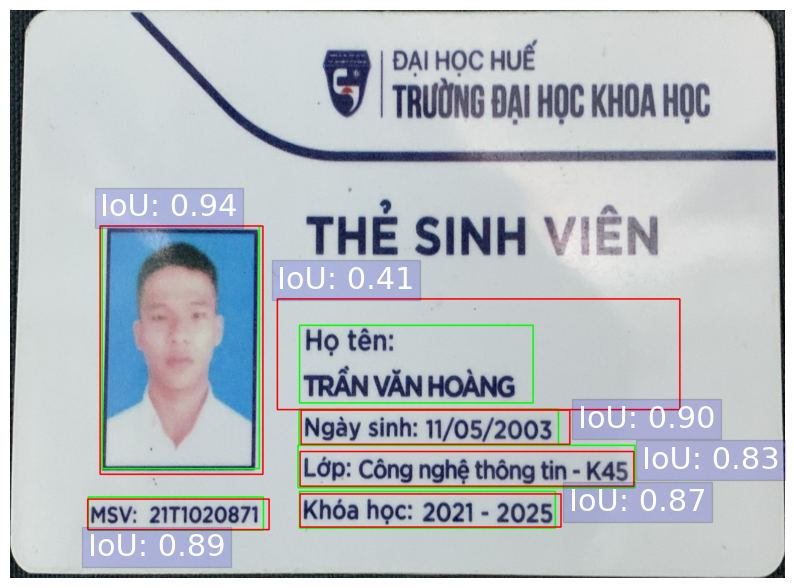

Ảnh: 2
iou của lop: 0.82
iou của nienkhoa: 0.75
iou của anhthe: 0.95
iou của ngaysinh: 0.80
iou của msv: 0.59
iou của hoten: 0.41


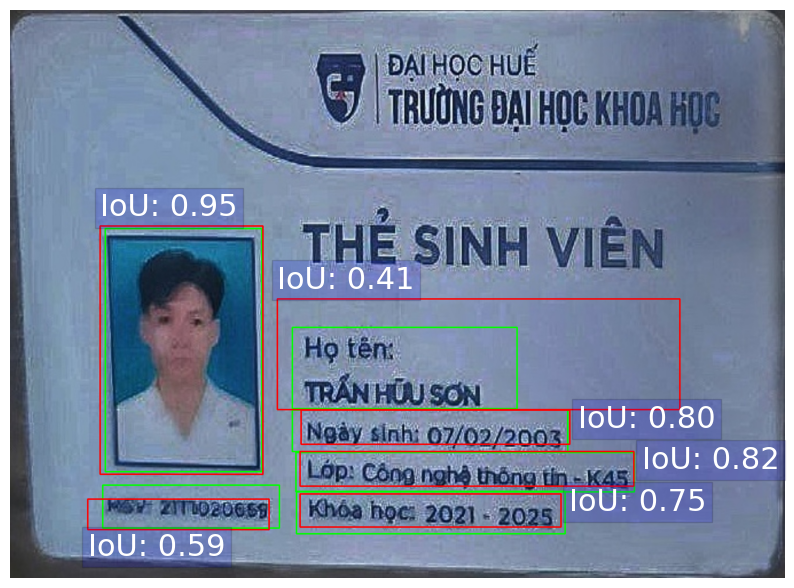

Ảnh: 3
iou của lop: 0.60
iou của nienkhoa: 0.66
iou của anhthe: 0.82
iou của ngaysinh: 0.56
iou của msv: 0.53
iou của hoten: 0.36


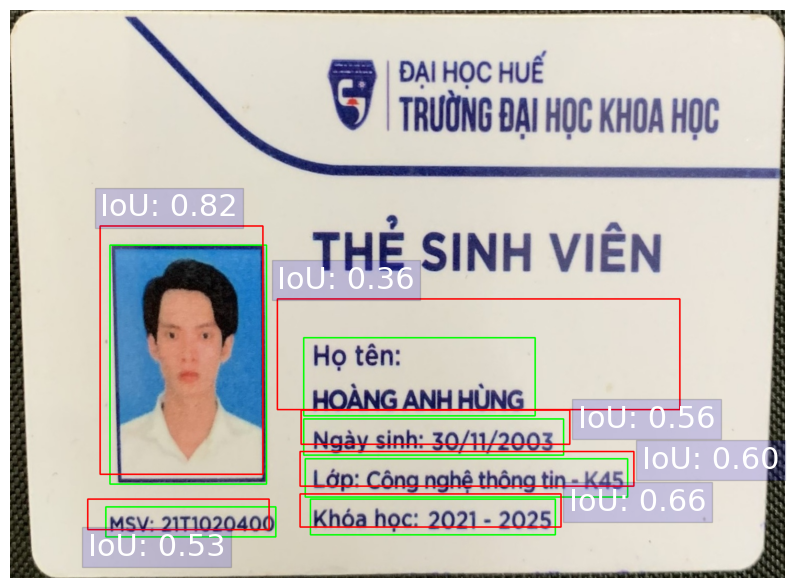

Ảnh: 4
iou của lop: 0.70
iou của nienkhoa: 0.83
iou của anhthe: 0.92
iou của ngaysinh: 0.57
iou của msv: 0.60
iou của hoten: 0.48


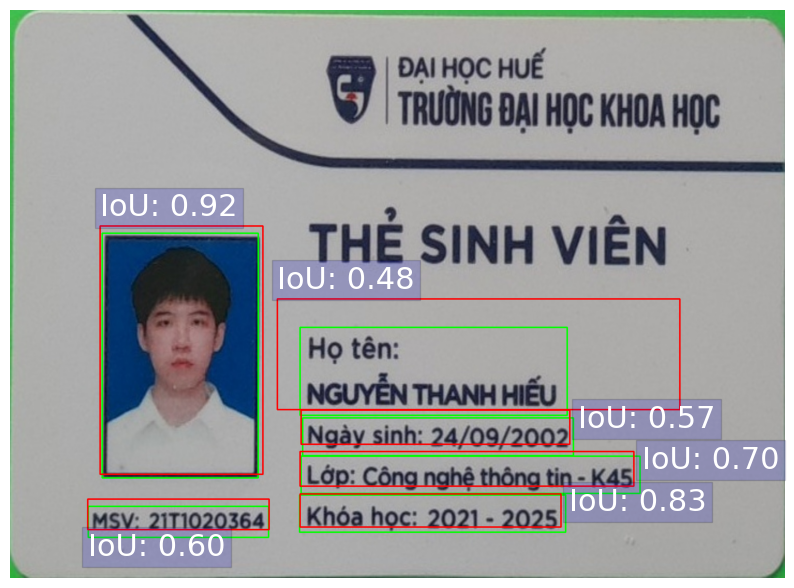

Ảnh: 5
iou của lop: 0.82
iou của nienkhoa: 0.85
iou của anhthe: 0.89
iou của ngaysinh: 0.60
iou của msv: 0.62
iou của hoten: 0.43


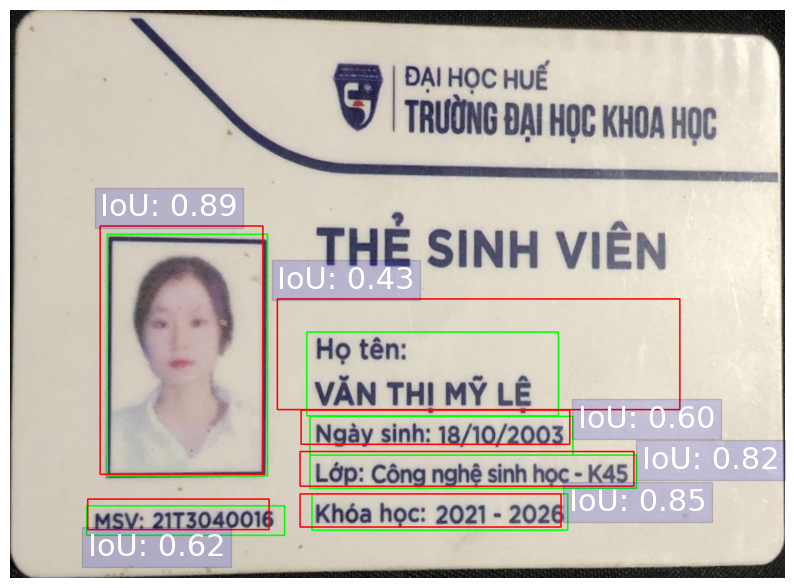

Ảnh: 6
iou của lop: 0.83
iou của nienkhoa: 0.79
iou của anhthe: 0.92
iou của ngaysinh: 0.77
iou của msv: 0.86
iou của hoten: 0.34


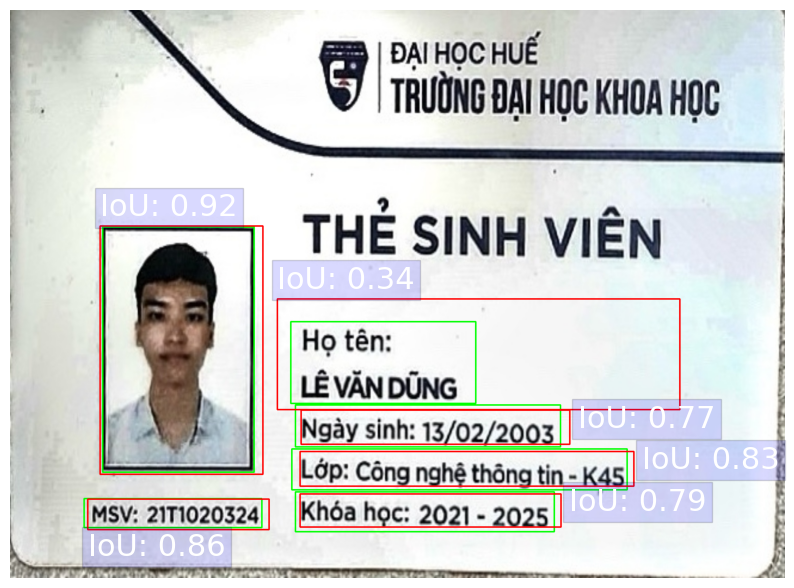

Ảnh: 7
iou của lop: 0.69
iou của nienkhoa: 0.43
iou của anhthe: 0.90
iou của ngaysinh: 0.63
iou của msv: 0.50
iou của hoten: 0.56


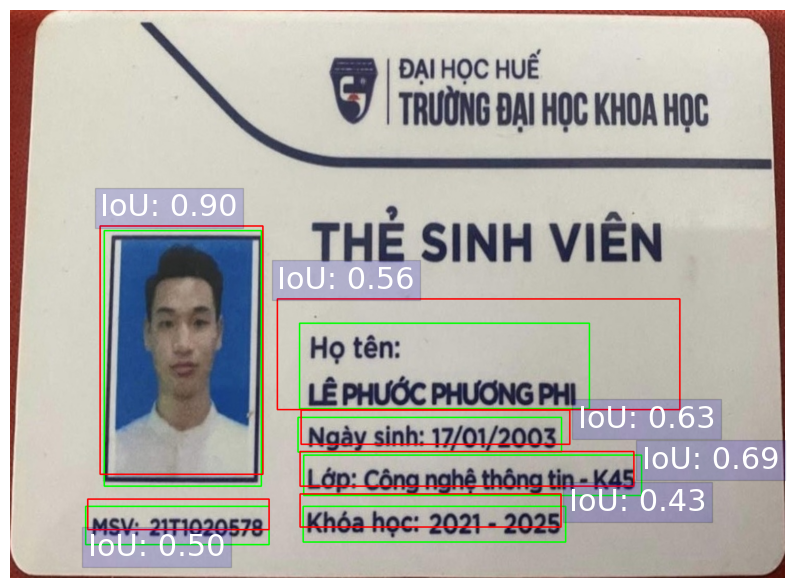

Ảnh: 8
iou của lop: 0.58
iou của nienkhoa: 0.73
iou của anhthe: 0.85
iou của ngaysinh: 0.51
iou của msv: 0.50
iou của hoten: 0.52


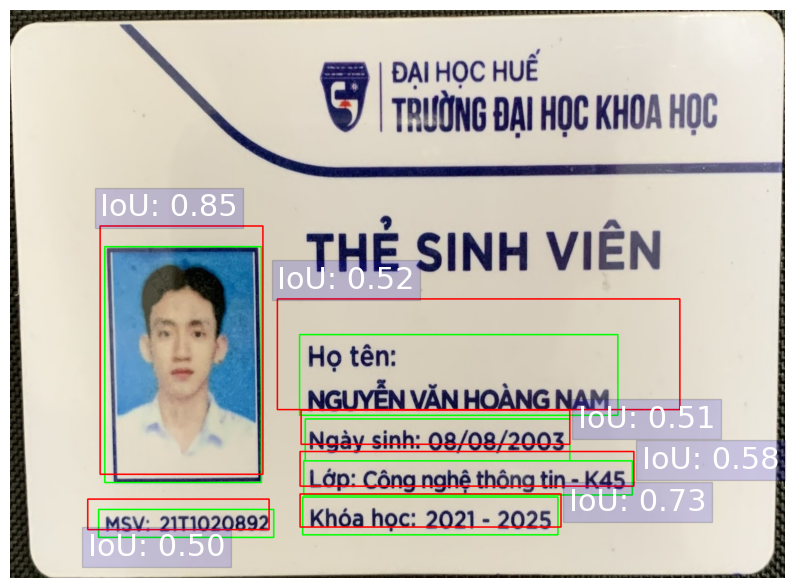

Ảnh: 9
iou của lop: 0.77
iou của nienkhoa: 0.84
iou của anhthe: 0.91
iou của ngaysinh: 0.88
iou của msv: 0.71
iou của hoten: 0.56


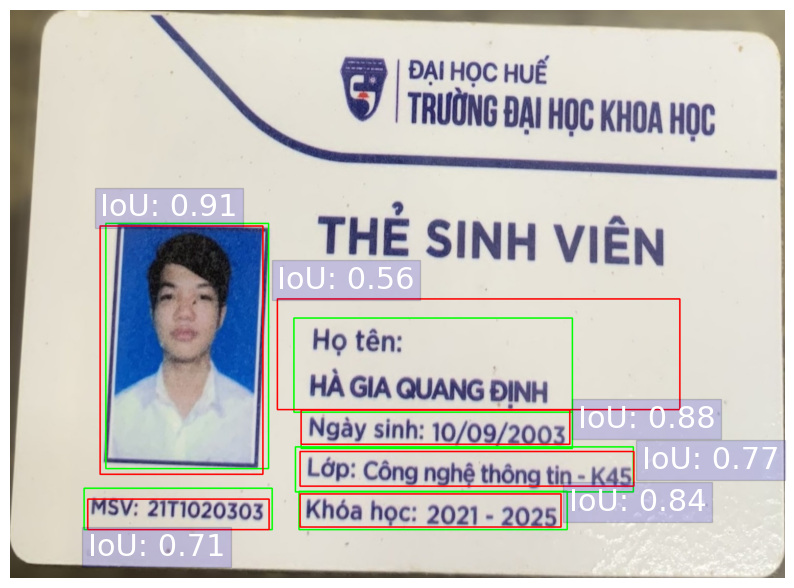

Ảnh: 10
iou của lop: 0.47
iou của nienkhoa: 0.62
iou của anhthe: 0.77
iou của ngaysinh: 0.36
iou của msv: 0.51
iou của hoten: 0.46


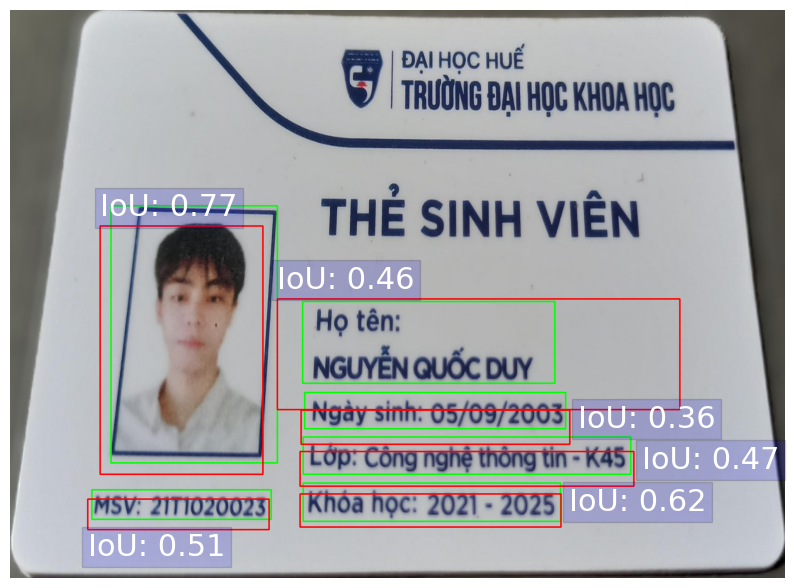

In [ ]:
import cv2
import matplotlib.pyplot as plt
import os

def calculate_iou(box1, box2):
    # Lấy tọa độ của vùng giao nhau
    x_left = max(box1['top_left'][0], box2['top_left'][0])
    y_top = max(box1['top_left'][1], box2['top_left'][1])
    x_right = min(box1['bottom_right'][0], box2['bottom_right'][0])
    y_bottom = min(box1['bottom_right'][1], box2['bottom_right'][1])

    # Tính diện tích của vùng giao nhau
    intersection_area = max(0, x_right - x_left + 1) * max(0, y_bottom - y_top + 1)

    # Tính diện tích của cả hai bounding box
    box1_area = (box1['bottom_right'][0] - box1['top_left'][0] + 1) * (box1['bottom_right'][1] - box1['top_left'][1] + 1)
    box2_area = (box2['bottom_right'][0] - box2['top_left'][0] + 1) * (box2['bottom_right'][1] - box2['top_left'][1] + 1)

    # Tính diện tích của vùng hợp
    union_area = box1_area + box2_area - intersection_area

    # Tính IoU
    iou = intersection_area / union_area

    return iou

def draw_bounding_boxes_with_iou(image_path, ground_truth, predictions, label_colors):
    # Đọc ảnh
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Chuyển ảnh sang RGB cho matplotlib

    # Tạo plot
    plt.figure(figsize=(10, 8))

    # Vẽ bounding box cho ground truth
    for gt_box in ground_truth:
        top_left_gt = tuple(map(int, gt_box['top_left']))
        bottom_right_gt = tuple(map(int, gt_box['bottom_right']))
        cv2.rectangle(image, top_left_gt, bottom_right_gt, (0, 255, 0), 2)  # Màu xanh cho ground truth

    # Vẽ bounding box cho dự đoán và tính IoU
    for pred_box in predictions:
        label = pred_box['label']
        top_left_pred = tuple(map(int, pred_box['top_left']))
        bottom_right_pred = tuple(map(int, pred_box['bottom_right']))
        bottom_left_pred = tuple(map(int, pred_box['bottom_left']))
        cv2.rectangle(image, top_left_pred, bottom_right_pred, (255, 0, 0), 2)  # Màu đỏ cho dự đoán

        # Tìm bounding box của ground truth tương ứng
        for gt_box in ground_truth:
            if gt_box['label'] == label:
                iou = calculate_iou(gt_box, pred_box)
                print(f'iou của {label}: {iou:.2f}')

                # Xác định vị trí vẽ IoU dựa trên nhãn
                if label in ['hoten', 'anhthe']:
                    text_position = (top_left_pred[0], top_left_pred[1] - 20)
                elif label == 'msv':
                    text_position = (bottom_left_pred[0], bottom_left_pred[1] + 50)
                else:
                    text_position = (bottom_right_pred[0] + 15, (top_left_pred[1] + bottom_right_pred[1]) // 2)

                # Vẽ text hiển thị IoU gần bounding box của dự đoán
                plt.text(text_position[0], text_position[1], f"IoU: {iou:.2f}", fontsize=22, color='white', bbox=dict(facecolor='blue', alpha=0.15))
                break

    # Hiển thị ảnh với các bounding box và IoU
    plt.imshow(image)
    plt.axis('off')
    plt.show()

input_directory = '/content/drive/MyDrive/Data-do_an_cuoi_ky/test_data_cuted&resize'
labelmap_path = '/content/drive/MyDrive/Data-do_an_cuoi_ky/test_data_Segmentation/labelmap.txt'

# Đọc file labelmap và lưu màu sắc cho từng nhãn
label_colors = load_label_colors(labelmap_path)

# Đọc các nhãn từ labelmap
labels = load_labels(labelmap_path)

i = 0
# Duyệt qua các file ảnh trong thư mục
for filename in os.listdir(input_directory):
    if filename.endswith(".jpg") or filename.endswith(".png") or filename.endswith(".jpeg"):  # Chỉ xử lý các tệp có đuôi là .jpg, .jpeg hoặc .png
        image_path = os.path.join(input_directory, filename)

        # Lấy tên ảnh từ đường dẫn
        image_name = os.path.basename(image_path)
        i += 1
        print('Ảnh:', i)

        # Lấy bounding box cho ground truth và dự đoán
        ground_truth, predictions = get_ground_truth_and_predictions(image_name)

        # Vẽ bounding box cho ground truth và dự đoán và hiển thị IoU
        draw_bounding_boxes_with_iou(image_path, ground_truth, predictions, label_colors)


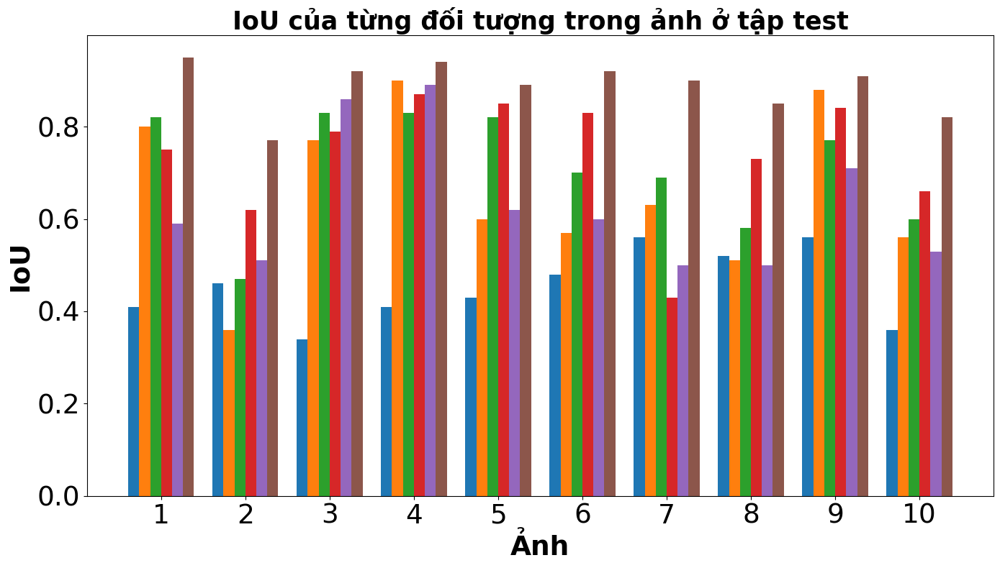

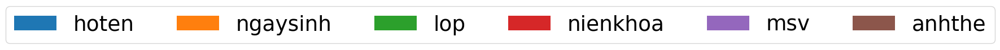

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Dữ liệu IoU
labels = ['hoten', 'ngaysinh', 'lop', 'nienkhoa', 'msv', 'anhthe']
data = [
    [0.41, 0.80, 0.82, 0.75, 0.59, 0.95],
    [0.46, 0.36, 0.47, 0.62, 0.51, 0.77],
    [0.34, 0.77, 0.83, 0.79, 0.86, 0.92],
    [0.41, 0.90, 0.83, 0.87, 0.89, 0.94],
    [0.43, 0.60, 0.82, 0.85, 0.62, 0.89],
    [0.48, 0.57, 0.70, 0.83, 0.60, 0.92],
    [0.56, 0.63, 0.69, 0.43, 0.50, 0.90],
    [0.52, 0.51, 0.58, 0.73, 0.50, 0.85],
    [0.56, 0.88, 0.77, 0.84, 0.71, 0.91],
    [0.36, 0.56, 0.60, 0.66, 0.53, 0.82]
]

# Chuyển đổi dữ liệu sang numpy array
data = np.array(data)
num_photos = data.shape[0]
num_objects = data.shape[1]

# Thiết lập vị trí cho các nhóm cột
x = np.arange(num_photos)
width = 0.13  # Độ rộng của mỗi cột

# Vẽ biểu đồ chính không có chú thích
fig, ax = plt.subplots(figsize=(14, 8))

for i in range(num_objects):
    ax.bar(x + i * width, data[:, i], width, label=labels[i])

# Thêm nhãn và tiêu đề với cỡ chữ lớn và in đậm
ax.set_xlabel('Ảnh', fontsize=27, fontweight='bold')
ax.set_ylabel('IoU', fontsize=27, fontweight='bold')
ax.set_title('IoU của từng đối tượng trong ảnh ở tập test', fontsize=25, fontweight='bold')
ax.set_xticks(x + width * (num_objects - 1) / 2)
ax.set_xticklabels([str(i+1) for i in range(num_photos)], fontsize=22)

# Định dạng trục x và y
plt.xticks(rotation=0, fontsize=27)
plt.yticks(fontsize=27)

# Hiển thị biểu đồ chính
plt.tight_layout()
plt.show()

# Vẽ biểu đồ chú thích riêng
fig_legend, ax_legend = plt.subplots(figsize=(12, 1))
fig_legend.legend(*ax.get_legend_handles_labels(), loc='center', ncol=num_objects, fontsize=27)
ax_legend.axis('off')  # Tắt trục của biểu đồ chú thích

# Hiển thị biểu đồ chú thích
plt.tight_layout()
plt.show()
